In [1]:
import tetra.utils.data_loader as dl
import tetra.utils.data_processor as dp
from tetra.utils import viewer
import importlib
import matplotlib.pyplot as plt
import os 
from pathlib import Path

In [2]:
dataset_path = "../dataset_sliced/split_1"
class_file = "../classes.txt"

In [38]:
#Load dataframe of all the bounding boxes
df = dl.df_bb(dataset_path,("train", "val"))
df["x_center"] = df["x_center"].astype(float)
df["y_center"] = df["y_center"].astype(float)
df["width"] = df["width"].astype(float)
df["height"] = df["height"].astype(float)
print(df.head())

                                                file class_id  x_center  \
0  04160107_JPG.rf.be45bb138b51b0f8446bce85e09da5...        0  0.978125   
1  04160107_JPG.rf.be45bb138b51b0f8446bce85e09da5...        0  0.414844   
2  04160107_JPG.rf.be45bb138b51b0f8446bce85e09da5...        0  0.542969   
3  04160107_JPG.rf.be45bb138b51b0f8446bce85e09da5...        0  0.266406   
4  04160107_JPG.rf.be45bb138b51b0f8446bce85e09da5...        0  0.337500   

   y_center     width    height  split  
0  0.317188  0.043750  0.071875  train  
1  0.378906  0.073438  0.070312  train  
2  0.387500  0.095312  0.065625  train  
3  0.450781  0.114062  0.085938  train  
4  0.317188  0.062500  0.071875  train  


In [39]:
df["area"] = df["width"].astype(float) * df["height"].astype(float)
df["aspect_ratio"] = df["height"] / df["width"]

In [40]:
n = 200
df_sorted = df.sort_values(by="aspect_ratio", ascending=False)
criticals = df_sorted.head(n)

../dataset_sliced/split_1\train\images\04160122_JPG.rf.9d4e265d806cfdd06a9cef2a94c7aed6_715_1024_512_1664_1152.png
['0', '0.972656', '0.451562', '0.0546875', '0.0625']
['0', '0.992188', '0.469531', '0.015625', '0.0640625']
0.0010009765625
4.1


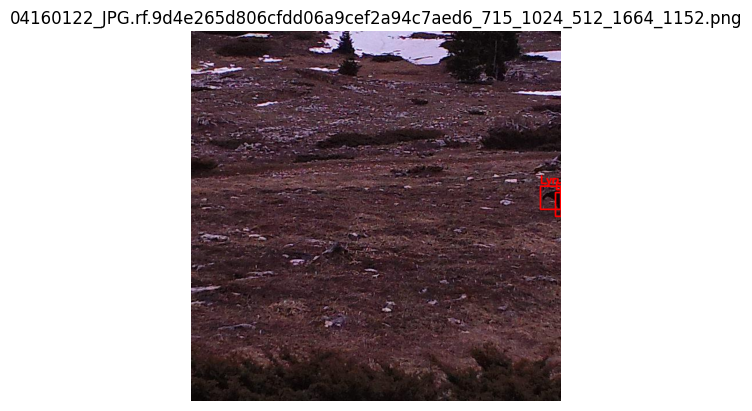

../dataset_sliced/split_1\train\images\04170039_JPG.rf.30828ed9fcd0224096afc613a417a217_1673_1536_512_2176_1152.png
['0', '0.1875', '0.36875', '0.121875', '0.084375']
['0', '0.620313', '0.399219', '0.078125', '0.0734375']
['0', '0.00859375', '0.430469', '0.0171875', '0.0765625']
0.0013159179687500001
4.454545454545454


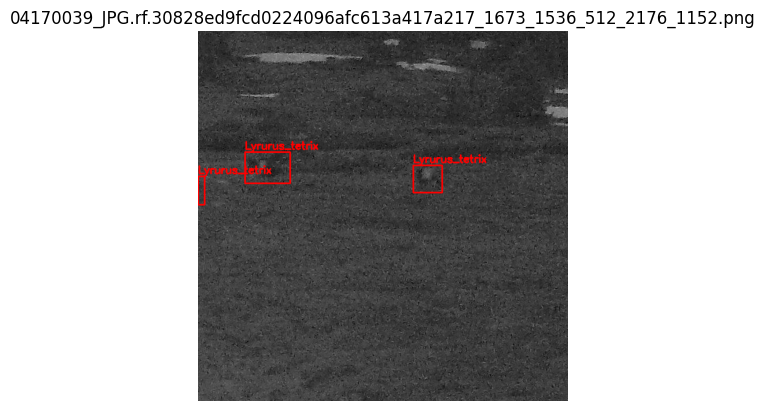

../dataset_sliced/split_1\train\images\04170039_JPG.rf.30828ed9fcd0224096afc613a417a217_1673_1952_512_2592_1152.png
['0', '0.0046875', '0.399219', '0.009375', '0.0734375']
0.0006884765625
7.833333333333334


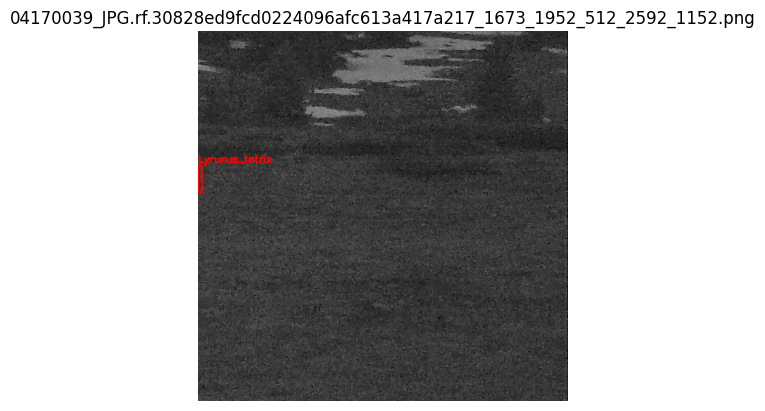

../dataset_sliced/split_1\train\images\04170044_JPG.rf.f5224d9f6de6766e9ee03793033b5747_1561_1952_512_2592_1152.png
['0', '0.00546875', '0.39375', '0.0109375', '0.075']
0.0008203125
6.857142857142858


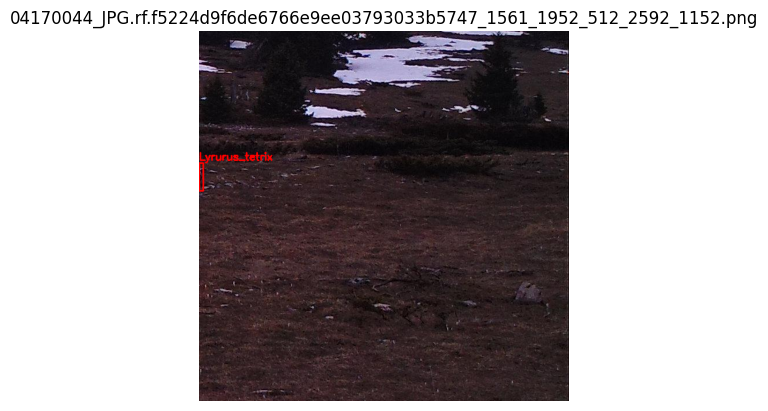

../dataset_sliced/split_1\train\images\04170044_JPG.rf.f5224d9f6de6766e9ee03793033b5747_1561_512_512_1152_1152.png
['0', '0.992188', '0.378125', '0.015625', '0.059375']
0.000927734375
3.8


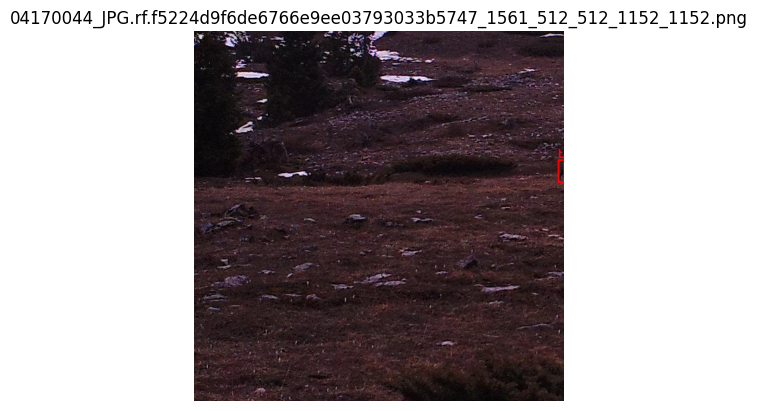

../dataset_sliced/split_1\train\images\04210199_JPG.rf.7ed07df5986cfc03001333af7f6b44ef_1153_1536_512_2176_1152.png
['0', '0.99375', '0.321094', '0.0125', '0.0890625']
['0', '0.974219', '0.328906', '0.0515625', '0.0671875']
0.0011132812500000001
7.125


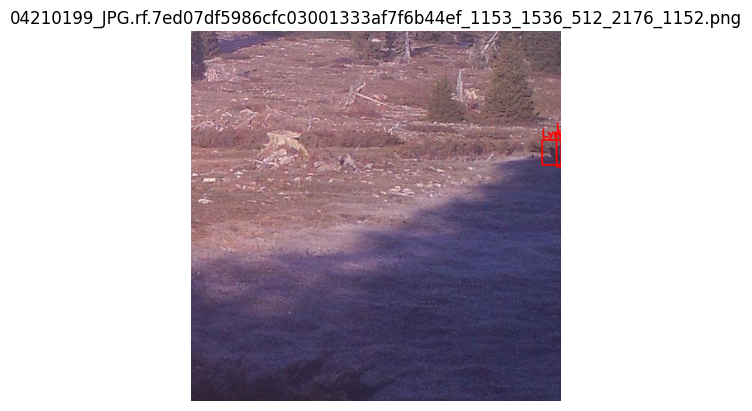

../dataset_sliced/split_1\train\images\04220238_JPG.rf.9bda64e977c6584a220aeee7ffd9e9fe_407_0_512_640_1152.png
['0', '0.992188', '0.472656', '0.015625', '0.0890625']
0.0013916015625
5.7


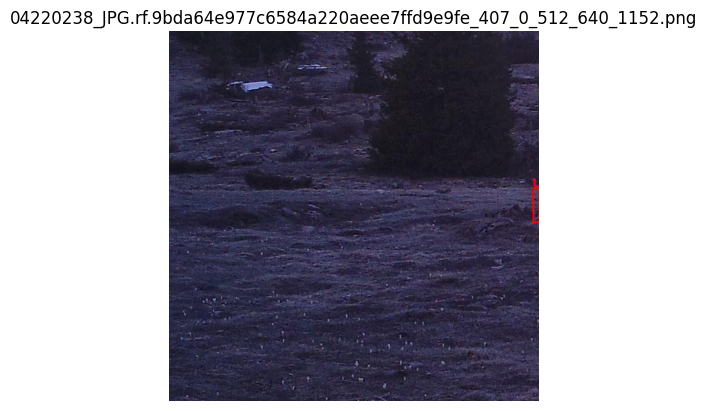

../dataset_sliced/split_1\train\images\04240322_JPG.rf.203c6e270f2dcad58c80fd1c6a7ecffb_2440_1536_512_2176_1152.png
['0', '0.992188', '0.384375', '0.015625', '0.065625']
0.001025390625
4.2


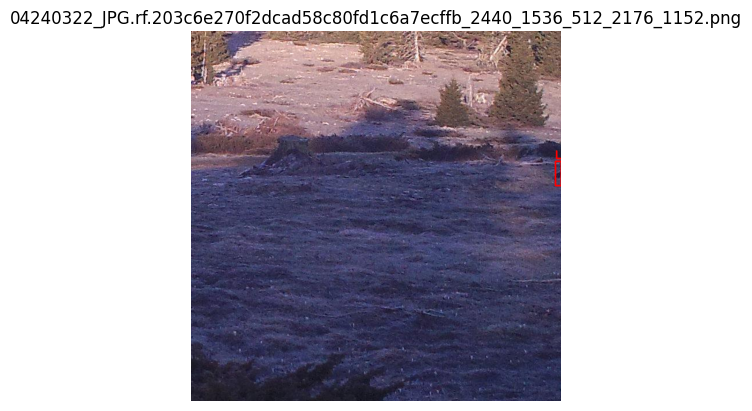

../dataset_sliced/split_1\train\images\04280120_JPG.rf.9cd93ae35a96dacd2db5cd945880956d_1527_1952_512_2592_1152.png
['0', '0.00859375', '0.392969', '0.0171875', '0.0640625']
0.00110107421875
3.7272727272727266


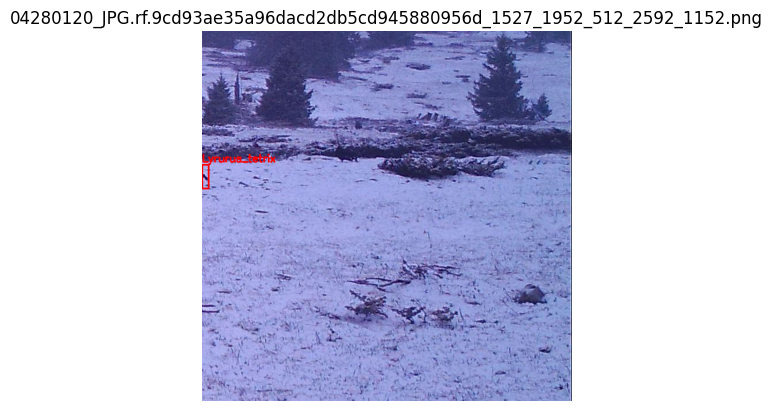

../dataset_sliced/split_1\train\images\04280127_JPG.rf.8deef93bb7c31ba51a2d31d06ad0af46_1017_0_512_640_1152.png
['0', '0.996875', '0.440625', '0.00625', '0.05']
0.00031250000000000006
8.0


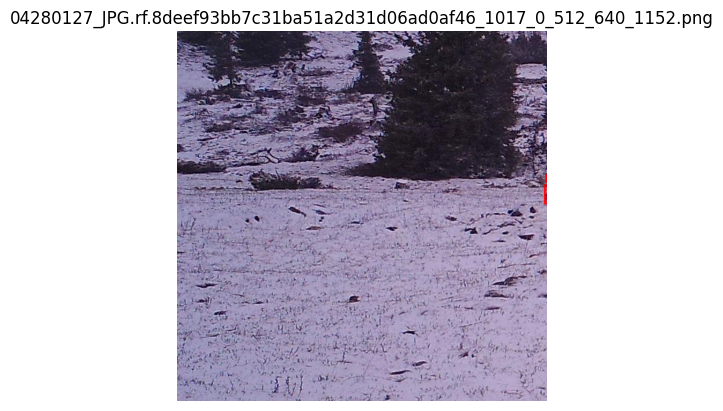

../dataset_sliced/split_1\train\images\04290942_JPG.rf.5d35ac6487673b520fe9fcbd99de9e52_1319_1952_0_2592_640.png
['0', '0.896094', '0.179688', '0.129688', '0.065625']
['0', '0.0078125', '0.257812', '0.015625', '0.075']
['0', '0.33125', '0.322656', '0.16875', '0.0890625']
0.001171875
4.8


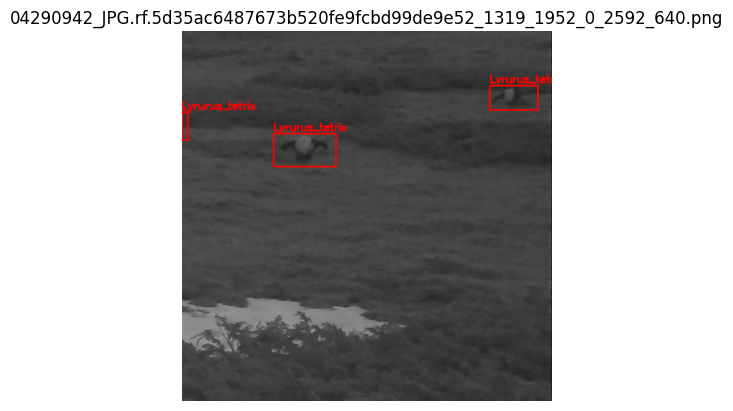

../dataset_sliced/split_1\train\images\04290945_JPG.rf.1613813c6d0b4a16f12a998e6fbe5835_2027_1536_0_2176_640.png
['0', '0.00859375', '0.282031', '0.0171875', '0.114062']
['0', '0.424219', '0.0976562', '0.114062', '0.0765625']
0.001960440625
6.636334545454544


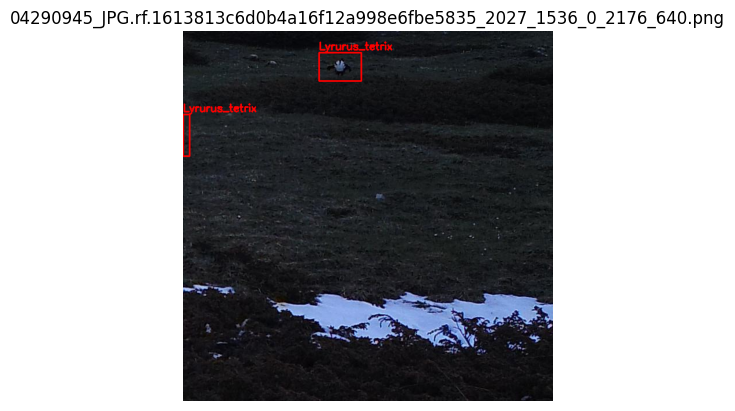

../dataset_sliced/split_1\train\images\04290949_JPG.rf.fab6074891dba535623996f21dd838c5_1082_1952_0_2592_640.png
['0', '0.00703125', '0.264062', '0.0140625', '0.05625']
['0', '0.285156', '0.296094', '0.117188', '0.0671875']
0.000791015625
4.0


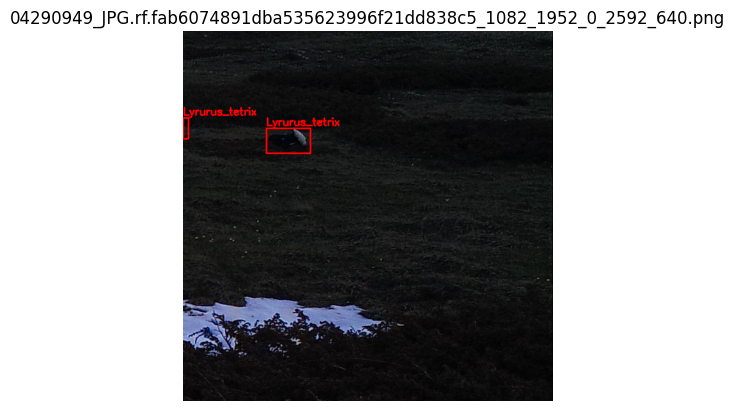

../dataset_sliced/split_1\train\images\05010020_JPG.rf.d484bae0653db1838ce3804e2c1b9550_1100_1536_0_2176_640.png
['0', '0.0132812', '0.321875', '0.0265625', '0.134375']
0.0035693359375
5.0588235294117645


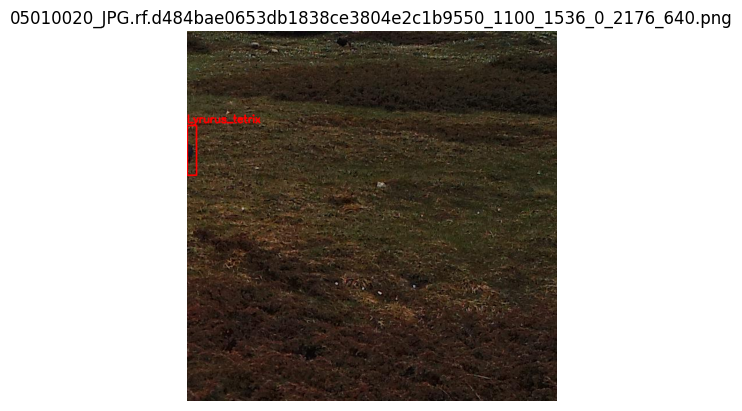

../dataset_sliced/split_1\train\images\05020045_JPG.rf.4cd075ff4c262174d2433f8154516ff4_1202_0_0_640_640.png
['0', '0.632812', '0.164062', '0.103125', '0.1125']
['0', '0.985938', '0.303906', '0.028125', '0.104688']
0.00294435
3.72224


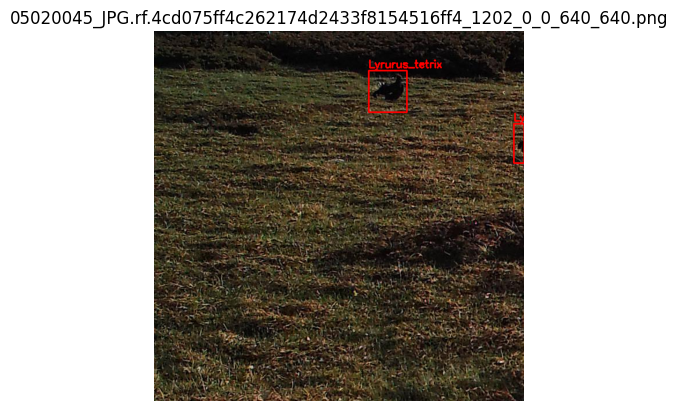

../dataset_sliced/split_1\train\images\05020055_JPG.rf.9d12a0731968c8715fd3db9b7d3c3a9b_90_1536_0_2176_640.png
['0', '0.288281', '0.221875', '0.126562', '0.109375']
['0', '0.992969', '0.0507812', '0.0140625', '0.0640625']
0.00090087890625
4.555555555555555


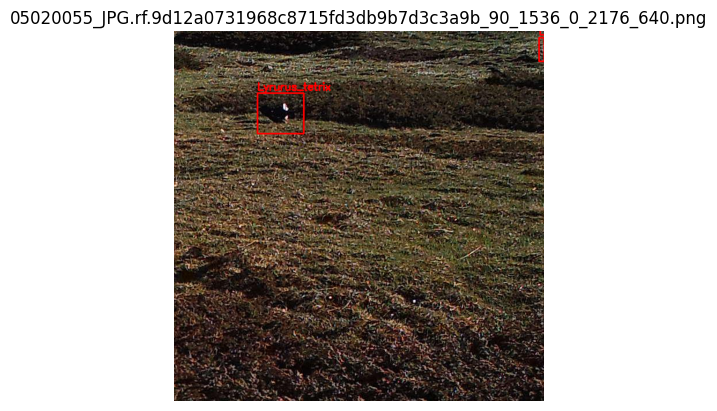

../dataset_sliced/split_1\train\images\05030089_JPG.rf.915a6649cc8a3abe3e8c3891df10cef9_1893_1536_0_2176_640.png
['0', '0.0125', '0.359375', '0.025', '0.146875']
0.0036718750000000002
5.875


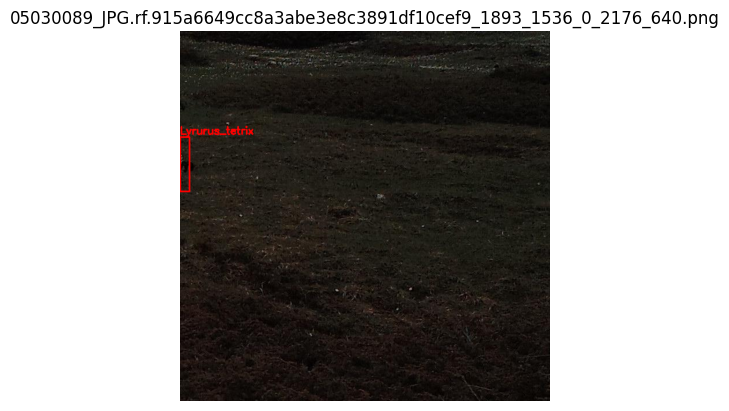

../dataset_sliced/split_1\train\images\05060159_JPG.rf.6cd2cb7c1ccc66b3835d2829a71ae4f2_859_1536_0_2176_640.png
['0', '0.349219', '0.207031', '0.101562', '0.107813']
['0', '0.99375', '0.3125', '0.0125', '0.140625']
0.0017578125
11.25


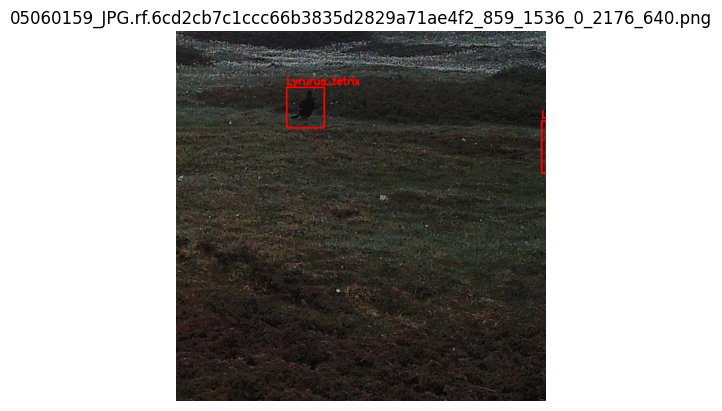

../dataset_sliced/split_1\train\images\05060169_JPG.rf.67461c71c8b81b21b3adfe7990bd188d_1802_1024_0_1664_640.png
['0', '0.00703125', '0.0695313', '0.0140625', '0.0671875']
0.00094482421875
4.777777777777778


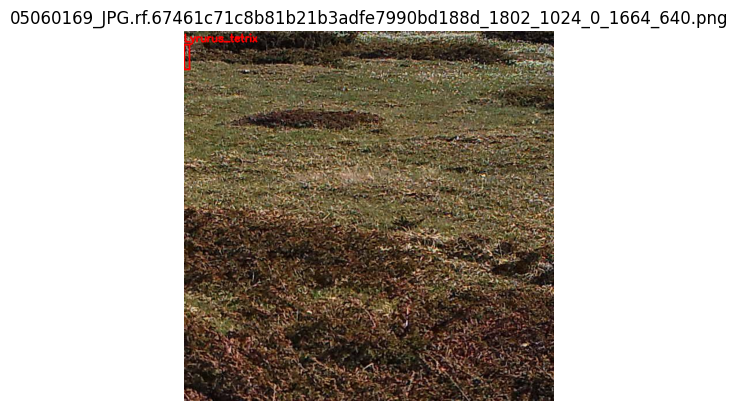

../dataset_sliced/split_1\train\images\05070192_JPG.rf.dab9af2f2e3814f094c8dd89c9edd490_1066_1952_0_2592_640.png
['0', '0.0125', '0.261719', '0.025', '0.0953125']
['0', '0.332031', '0.0765625', '0.0390625', '0.059375']
0.0023828125
3.8124999999999996


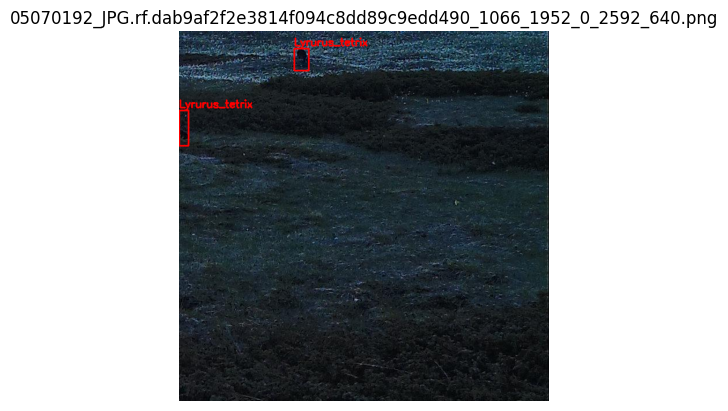

../dataset_sliced/split_1\train\images\05080215_JPG.rf.2f728de8ef6608925594385f2060b0a3_2211_1536_0_2176_640.png
['0', '0.00546875', '0.25625', '0.0109375', '0.08125']
['0', '0.435937', '0.0703125', '0.11875', '0.078125']
0.0008886718749999999
7.42857142857143


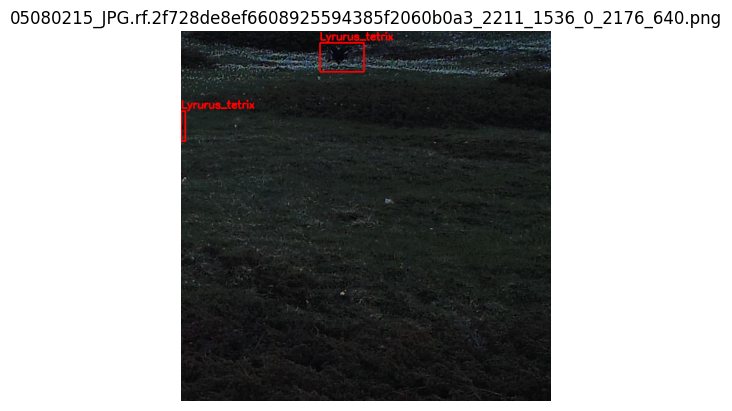

../dataset_sliced/split_1\train\images\05080226_JPG.rf.68b94ef558843bff4199cf6772c3c950_418_1024_0_1664_640.png
['0', '0.985938', '0.472656', '0.028125', '0.148438']
0.00417481875
5.277795555555555


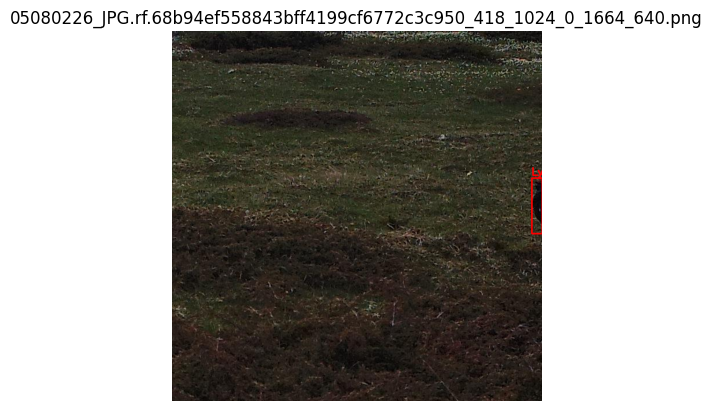

../dataset_sliced/split_1\train\images\05100255_JPG.rf.b639312244523e9b9b88ed3ffef27a2e_666_0_0_640_640.png
['0', '0.985938', '0.566406', '0.028125', '0.201563']
0.005668959375
7.166684444444444


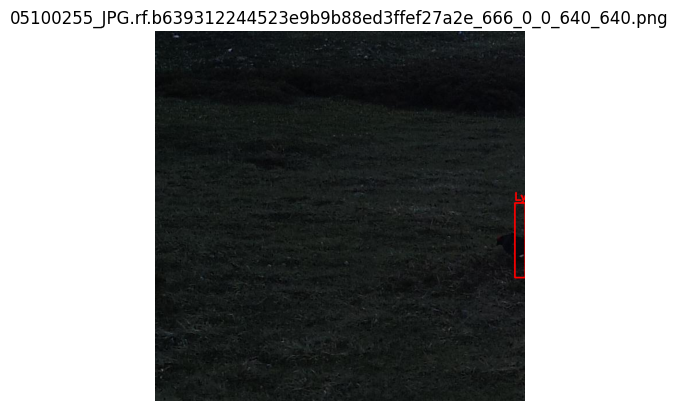

../dataset_sliced/split_1\train\images\05120303_JPG.rf.79d90c9dbc47b4e003631425883a1405_96_1024_0_1664_640.png
['0', '0.992188', '0.151562', '0.015625', '0.125']
0.001953125
8.0


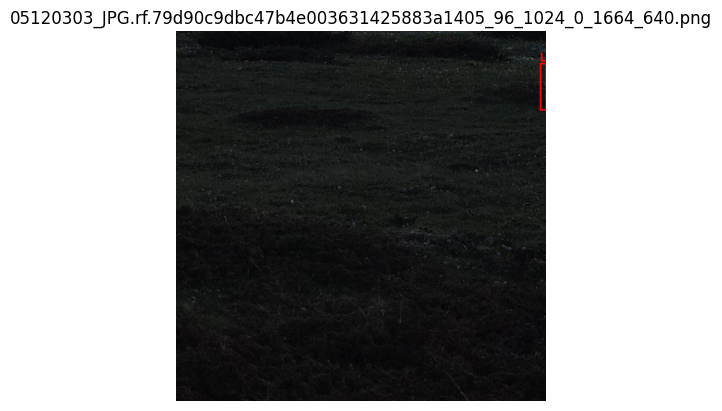

../dataset_sliced/split_1\train\images\05170542_JPG.rf.f03013a73a768e17e31ab29b5b09263b_10_1536_0_2176_640.png
['0', '0.990625', '0.257812', '0.01875', '0.1']
['0', '0.514062', '0.321875', '0.15', '0.103125']
['0', '0.79375', '0.332813', '0.134375', '0.125']
0.001875
5.333333333333334


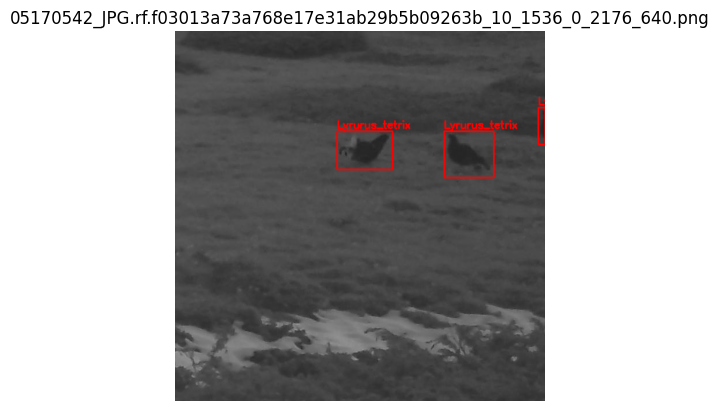

../dataset_sliced/split_1\train\images\05170544_JPG.rf.c6903695fdd9826435d91e6cc92c1f1d_585_1536_0_2176_640.png
['0', '0.00703125', '0.240625', '0.0140625', '0.075']
0.0010546875
5.333333333333333


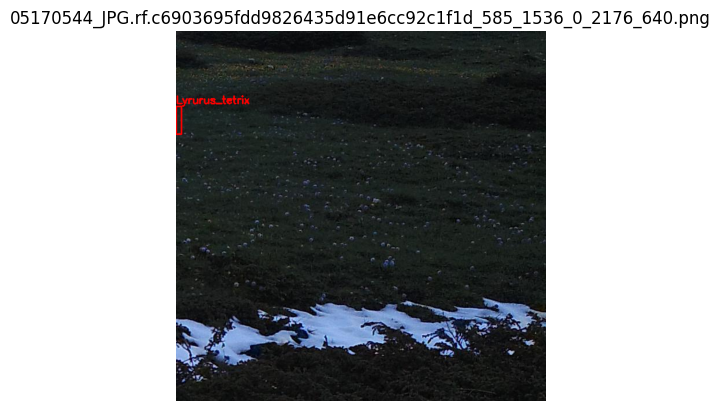

../dataset_sliced/split_1\train\images\05190591_JPG.rf.de64840ea443bb4ea08bdcb50528ba46_1987_1024_512_1664_1152.png
['0', '0.973437', '0.338281', '0.053125', '0.0359375']
['0', '0.00390625', '0.395313', '0.0078125', '0.0375']
0.00029296875
4.8


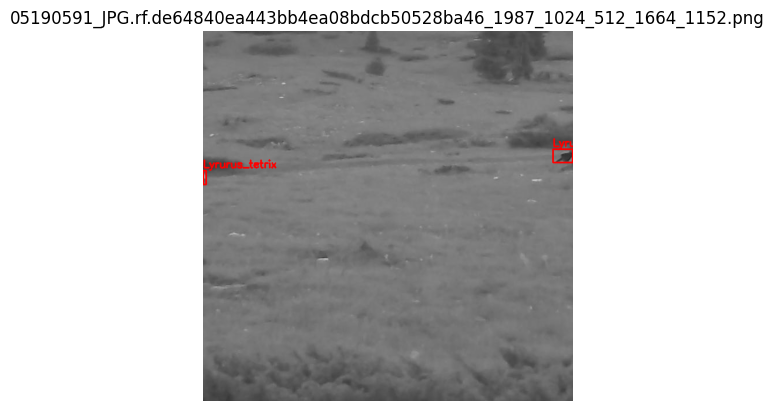

../dataset_sliced/split_1\train\images\05190594_JPG.rf.81238704303137b5f8f7778b4c739f0d_583_512_0_1152_640.png
['0', '0.984375', '0.375', '0.03125', '0.15625']
0.0048828125
5.0


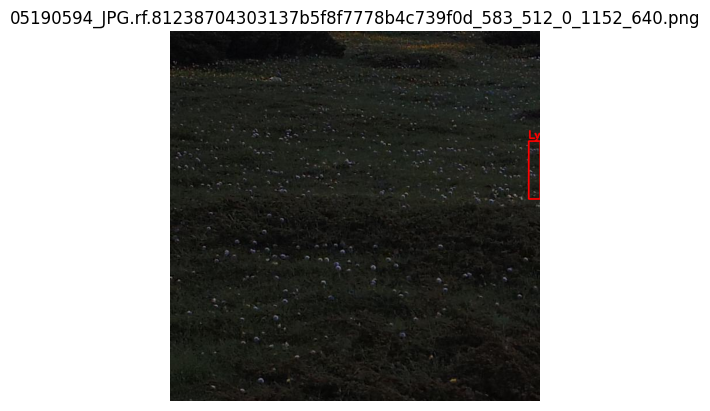

../dataset_sliced/split_1\train\images\05190604_JPG.rf.5b08721fed5ab4e6a173192e1ea87d44_2044_1952_0_2592_640.png
['0', '0.0195312', '0.290625', '0.0390625', '0.18125']
0.007080078125
4.64


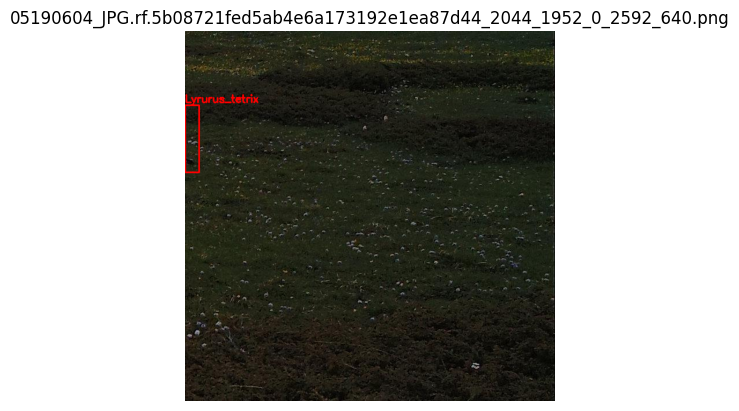

../dataset_sliced/split_1\train\images\05200616_JPG.rf.55e53b7b5897252d09ed3ff032fe1fe3_1404_1952_0_2592_640.png
['0', '0.246875', '0.245312', '0.090625', '0.078125']
['0', '0.0171875', '0.496094', '0.034375', '0.123438']
0.00424318125
3.590923636363636


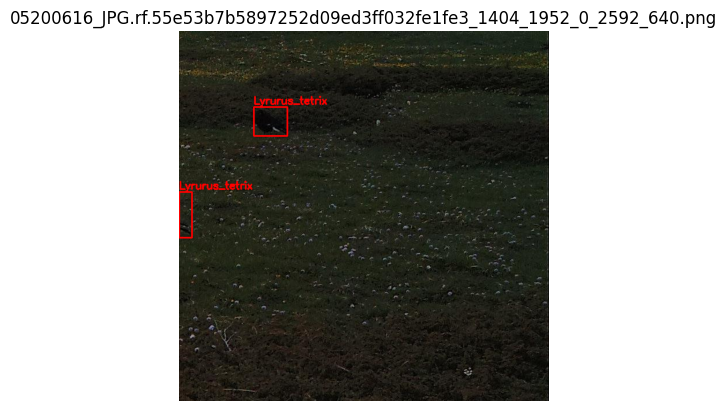

../dataset_sliced/split_1\train\images\05210649_JPG.rf.cd337e723d2b7ac5c6d1650616ac3589_1899_512_0_1152_640.png
['0', '0.0078125', '0.303125', '0.015625', '0.075']
0.001171875
4.8


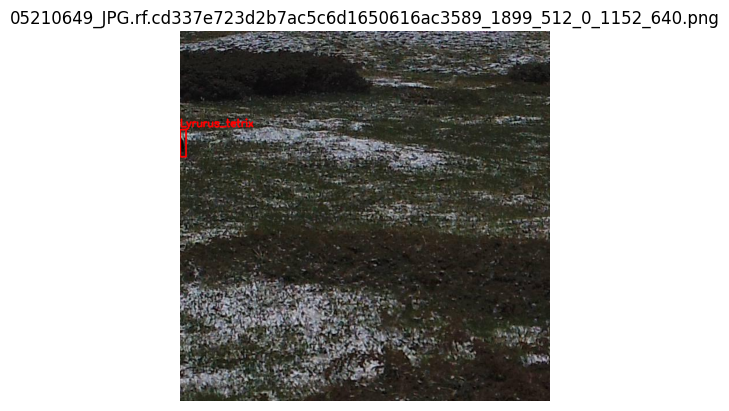

../dataset_sliced/split_1\train\images\05220659_JPG.rf.2e6cbca509dab7a8db4a39e94b146048_341_1536_512_2176_1152.png
['0', '0.996094', '0.317969', '0.0078125', '0.0546875']
0.00042724609375
7.0


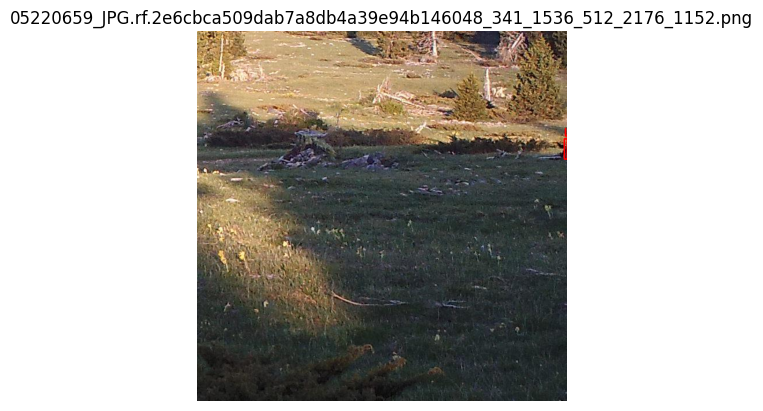

../dataset_sliced/split_1\train\images\05270790_JPG.rf.71b9cf23e4b86ff47f82fb86325f912b_167_512_0_1152_640.png
['0', '0.9875', '0.273438', '0.025', '0.140625']
0.003515625
5.625


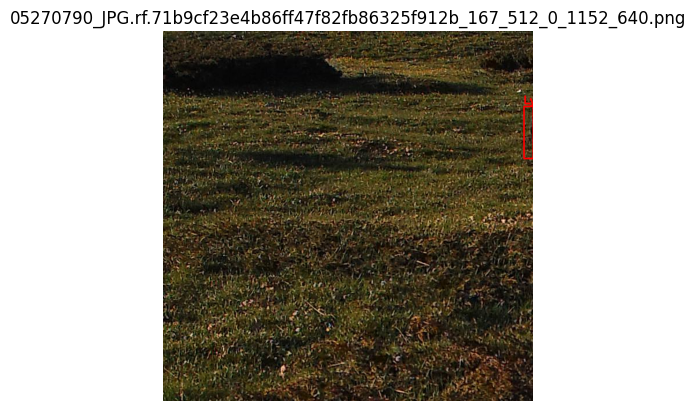

../dataset_sliced/split_1\train\images\05280796_JPG.rf.970cf16e08ca90cd5659c2b85ac95fc2_632_1536_0_2176_640.png
['0', '0.0148437', '0.234375', '0.0296875', '0.115625']
['0', '0.149219', '0.251563', '0.126562', '0.090625']
['0', '0.902344', '0.30625', '0.185938', '0.121875']
0.0034326171875
3.8947368421052637


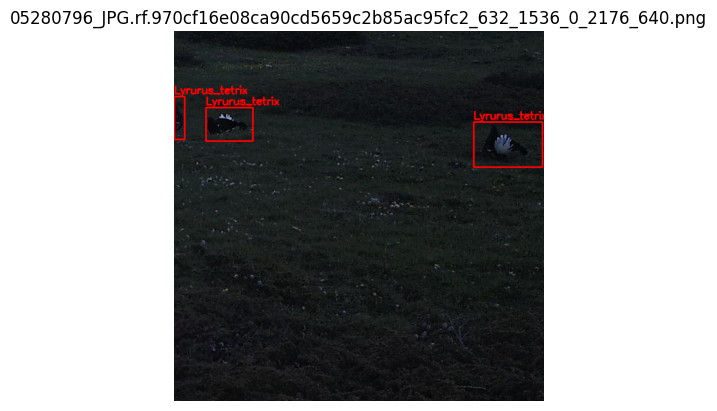

../dataset_sliced/split_1\train\images\05290827_JPG.rf.8862b3faede9d603eab66aa136b7981f_580_1536_0_2176_640.png
['0', '0.992188', '0.332031', '0.015625', '0.117188']
0.0018310625
7.500032


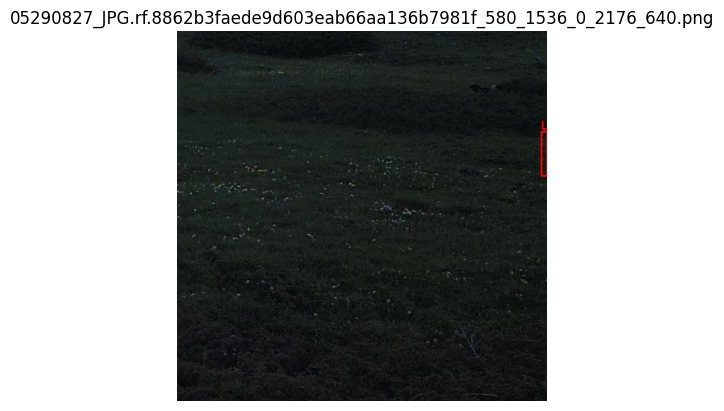

../dataset_sliced/split_1\train\images\05310873_JPG.rf.7ff49d62397a7d7ba2dd80ce45e6b02d_300_1536_0_2176_640.png
['0', '0.0109375', '0.255469', '0.021875', '0.0953125']
['0', '0.103125', '0.267188', '0.1125', '0.1']
['0', '0.690625', '0.123438', '0.0625', '0.046875']
0.0020849609375
4.357142857142857


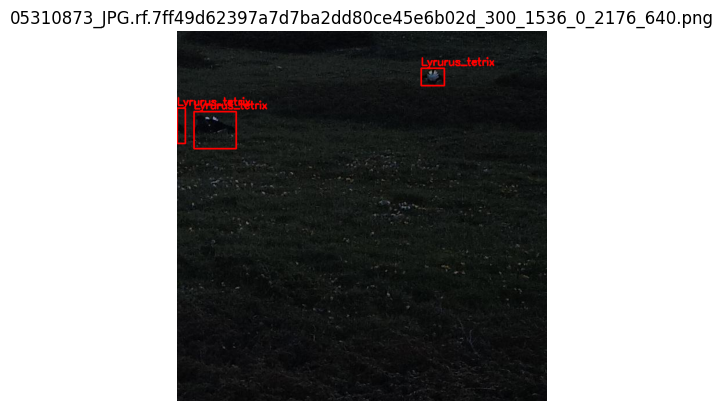

../dataset_sliced/split_1\train\images\06030935_JPG.rf.c33c84cdcd810892ed584fa910d623b1_128_1536_1024_2176_1664.png
['0', '0.975', '0.323437', '0.05', '0.18125']
0.0090625
3.6249999999999996


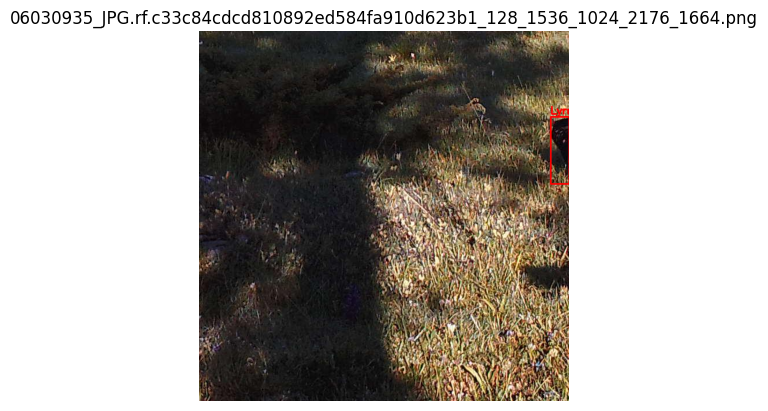

../dataset_sliced/split_1\train\images\06050007_JPG.rf.b969b1706e0d61ce3d98395095d228b2_1434_1536_0_2176_640.png
['0', '0.00703125', '0.188281', '0.0140625', '0.0734375']
['0', '0.372656', '0.10625', '0.0796875', '0.034375']
0.00103271484375
5.222222222222222


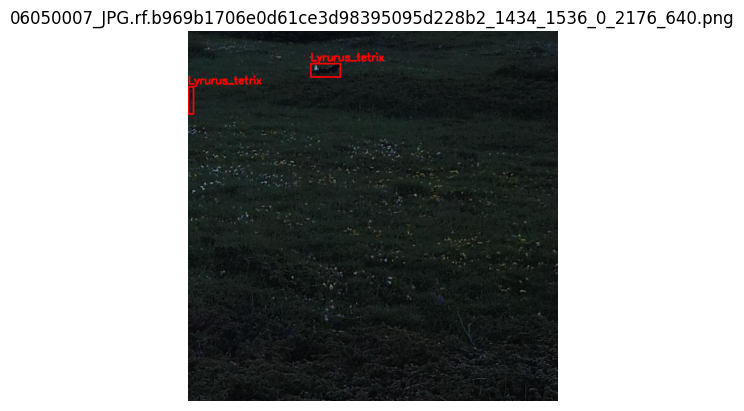

../dataset_sliced/split_1\train\images\06060021_JPG.rf.ce62a4303fb01ad31f580f4556ca70da_66_0_0_640_640.png
['0', '0.99375', '0.210156', '0.0125', '0.0859375']
['0', '0.166406', '0.304688', '0.117188', '0.125']
0.00107421875
6.875


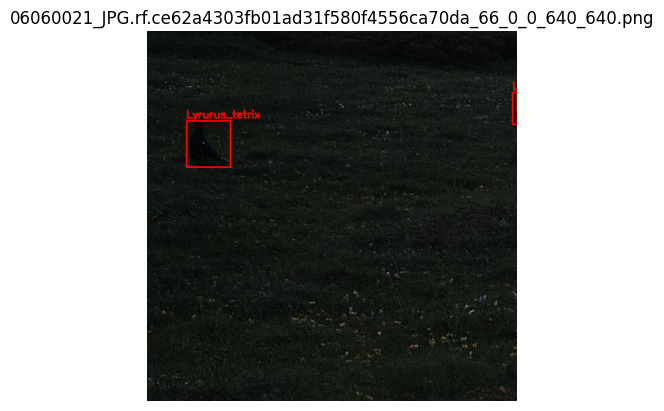

../dataset_sliced/split_1\train\images\06060027_JPG.rf.93cf3f5638465223d1064d5de49292d0_721_1536_0_2176_640.png
['0', '0.0078125', '0.232813', '0.015625', '0.075']
['0', '0.632812', '0.108594', '0.0625', '0.0578125']
0.001171875
4.8


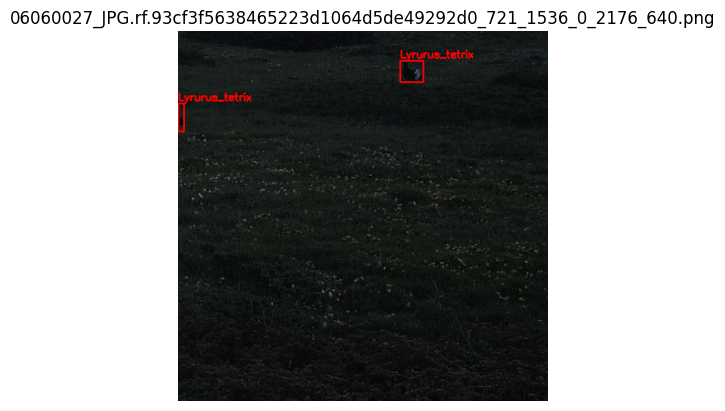

../dataset_sliced/split_1\train\images\06060027_JPG.rf.93cf3f5638465223d1064d5de49292d0_721_1952_0_2592_640.png
['0', '0.76875', '0.185156', '0.071875', '0.0390625']
['0', '0.00703125', '0.108594', '0.0140625', '0.0578125']
0.00081298828125
4.111111111111112


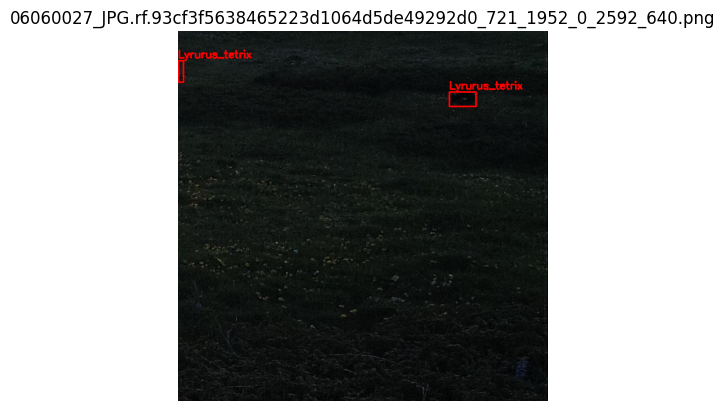

../dataset_sliced/split_1\train\images\06060028_JPG.rf.c98bd9bf5938188ac822f02777afc898_248_1024_0_1664_640.png
['0', '0.989844', '0.250781', '0.0203125', '0.0953125']
0.00193603515625
4.692307692307692


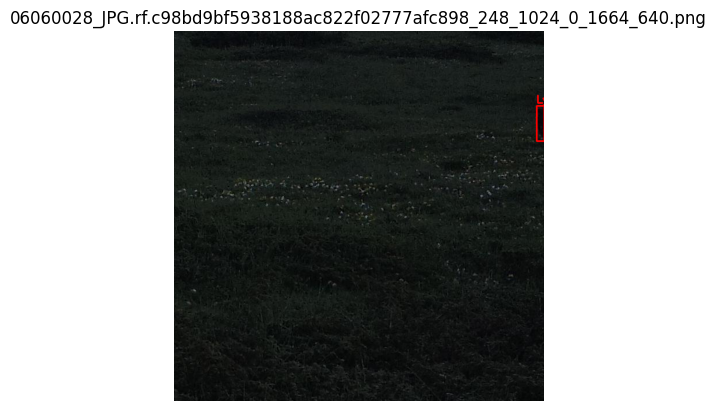

../dataset_sliced/split_1\train\images\06070048_JPG.rf.c2103f78ff8fd889060f5e8abe868bde_709_512_0_1152_640.png
['0', '0.996094', '0.0773438', '0.0078125', '0.0515625']
['0', '0.271875', '0.147656', '0.09375', '0.0828125']
0.00040283203125
6.6


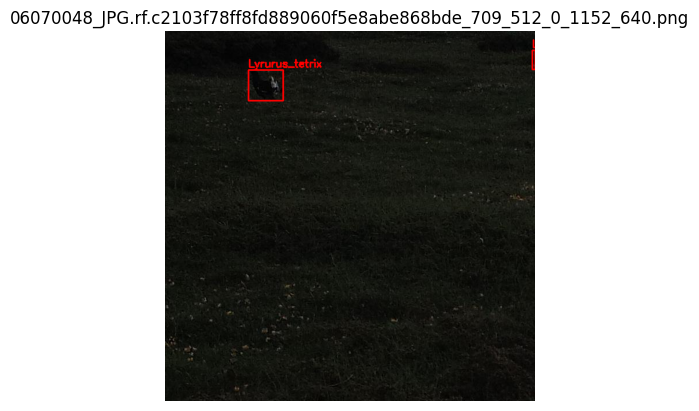

../dataset_sliced/split_1\train\images\06080036_JPG.rf.65d76c7ec5e8d367054939310341f705_227_1024_512_1664_1152.png
['0', '0.996875', '0.345313', '0.00625', '0.034375']
['0', '0.3875', '0.4125', '0.034375', '0.040625']
0.00021484375000000003
5.5


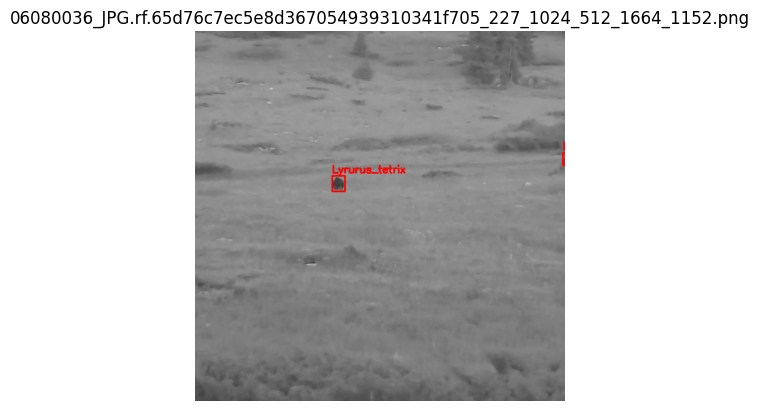

../dataset_sliced/split_1\train\images\06080043_JPG.rf.3e2f80aaa2d60220bc108d4e61b3982e_363_1024_512_1664_1152.png
['0', '0.519531', '0.416406', '0.0828125', '0.0515625']
['0', '0.00546875', '0.4625', '0.0109375', '0.065625']
0.0007177734375
6.000000000000001


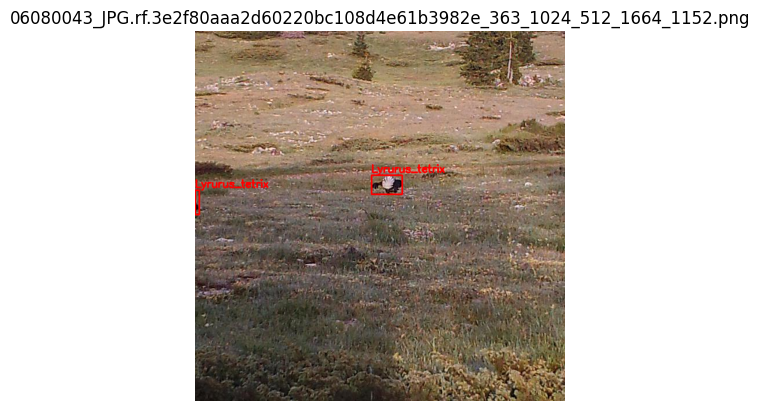

../dataset_sliced/split_1\train\images\06080064_JPG.rf.ffed0c0dc06ccf045c375cb027f8f5ca_878_1024_0_1664_640.png
['0', '0.0078125', '0.223438', '0.015625', '0.05625']
0.00087890625
3.6


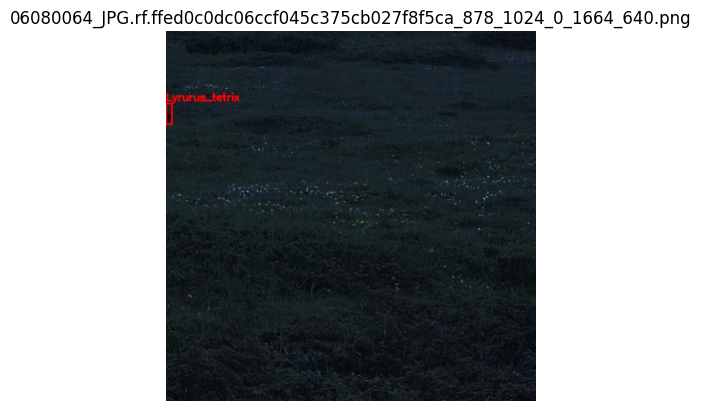

../dataset_sliced/split_1\train\images\06090097_JPG.rf.ba278350b9ab4b14f49bcaba3eb39eb7_1188_1536_0_2176_640.png
['0', '0.00625', '0.214062', '0.0125', '0.075']
['0', '0.964844', '0.330469', '0.0703125', '0.0796875']
0.0009375
5.999999999999999


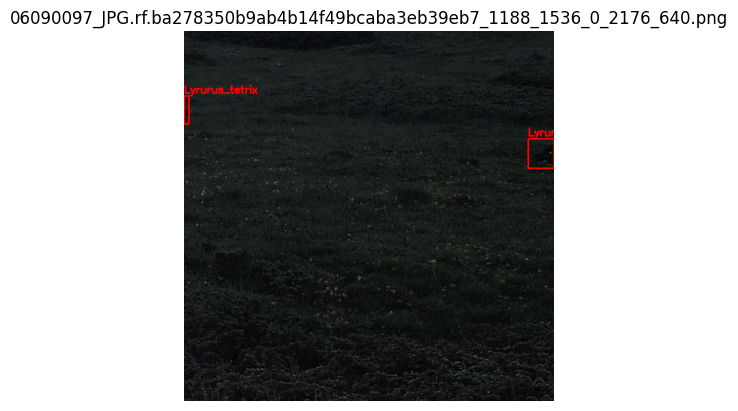

../dataset_sliced/split_1\train\images\06090102_JPG.rf.0695ddd74e04f39de432e2042c46a023_2006_1024_0_1664_640.png
['0', '0.750781', '0.228906', '0.117188', '0.0828125']
['0', '0.364063', '0.101562', '0.090625', '0.0625']
['0', '0.009375', '0.138281', '0.01875', '0.0796875']
0.0014941406249999998
4.25


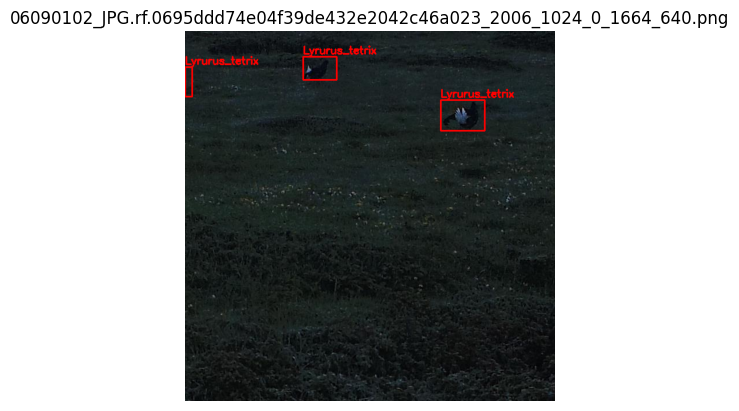

../dataset_sliced/split_1\train\images\06090123_JPG.rf.2feed375a2920f1d1ce9b291828ca69e_2246_512_0_1152_640.png
['0', '0.99375', '0.178906', '0.0125', '0.0765625']
0.0009570312500000001
6.125


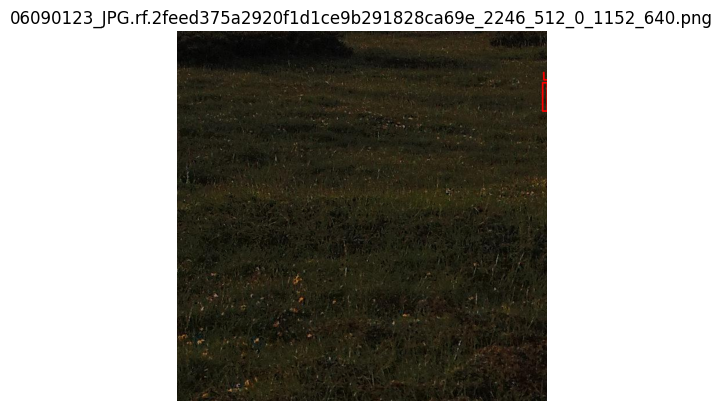

../dataset_sliced/split_1\train\images\06110115_JPG.rf.2a2a65f6ba61440a5a1c579750311c0d_1865_1536_512_2176_1152.png
['0', '0.996094', '0.335938', '0.0078125', '0.040625']
['0', '0.864062', '0.3375', '0.05', '0.0625']
0.0003173828125
5.2


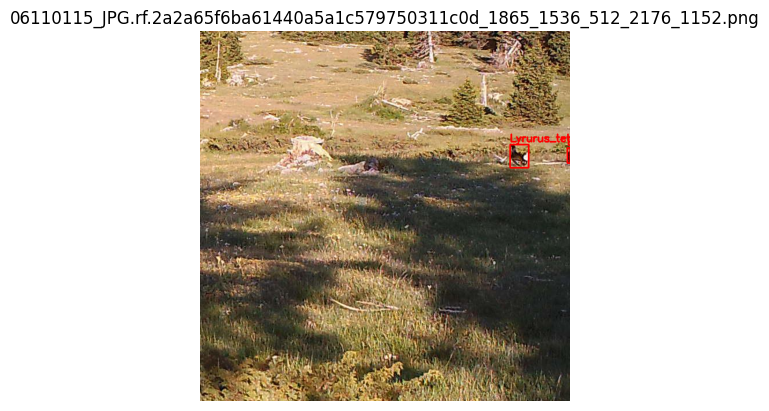

../dataset_sliced/split_1\train\images\06160766v_JPG.rf.c13ed2d2007a2ec02648bf28b5285d5a_1328_0_1024_640_1664.png
['0', '0.989844', '0.613281', '0.0203125', '0.145313']
0.0029516703125000003
7.153870769230769


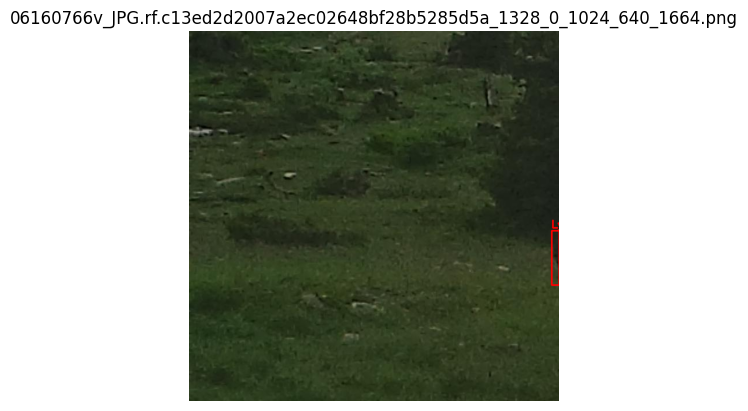

../dataset_sliced/split_1\train\images\MFDC0128_JPG.rf.7aa4cbf2f61d7360c6662f6c6115712e_830_3584_0_4224_640.png
['0', '0.992188', '0.689844', '0.015625', '0.0765625']
0.0011962890625
4.9


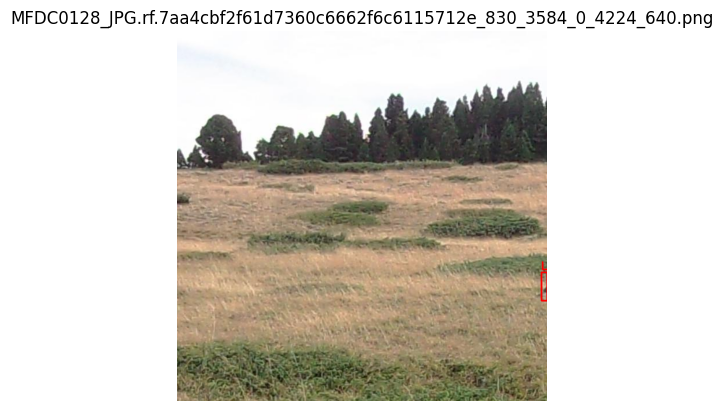

../dataset_sliced/split_1\train\images\MFDC0525_JPG.rf.5a3000976f9b4c1122ff13caaa7ae6c5_757_4608_0_5248_640.png
['0', '0.00390625', '0.839063', '0.0078125', '0.03125']
0.000244140625
4.0


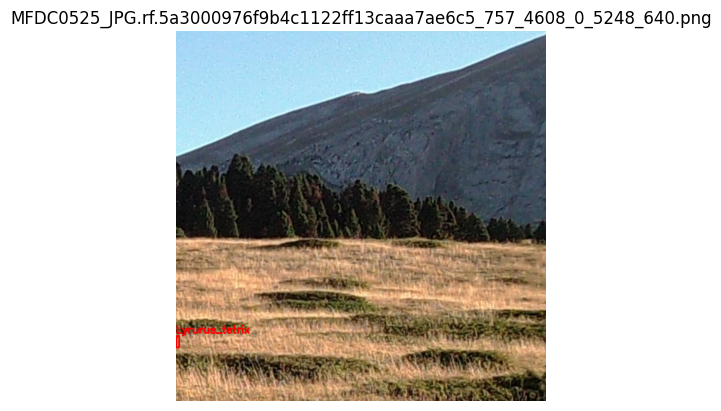

../dataset_sliced/split_1\train\images\MFDC0525_JPG.rf.5a3000976f9b4c1122ff13caaa7ae6c5_757_4608_512_5248_1152.png
['0', '0.00390625', '0.0390625', '0.0078125', '0.03125']
0.000244140625
4.0


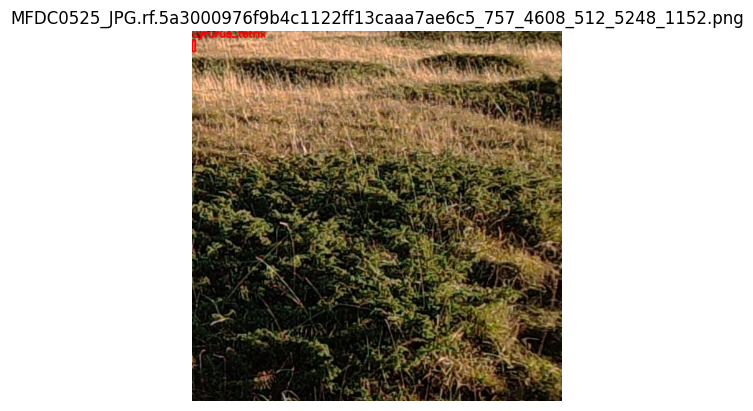

../dataset_sliced/split_1\train\images\MFDC1673_JPG.rf.cb983d6b06b3b040bde4e1e8bdd59636_1838_3584_0_4224_640.png
['0', '0.996094', '0.683594', '0.0078125', '0.0390625']
0.00030517578125
5.0


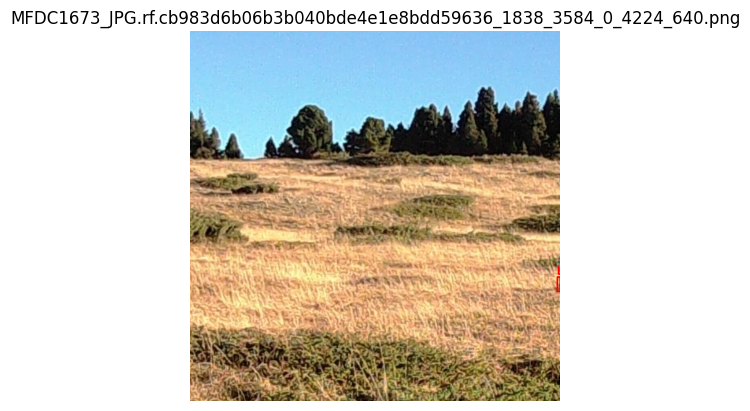

../dataset_sliced/split_1\train\images\MFDC2317_JPG.rf.6a72ac740802193cea4553a100a17ba9_682_4096_0_4736_640.png
['0', '0.9', '0.539844', '0.025', '0.0234375']
['0', '0.996875', '0.603906', '0.00625', '0.0421875']
0.000263671875
6.75


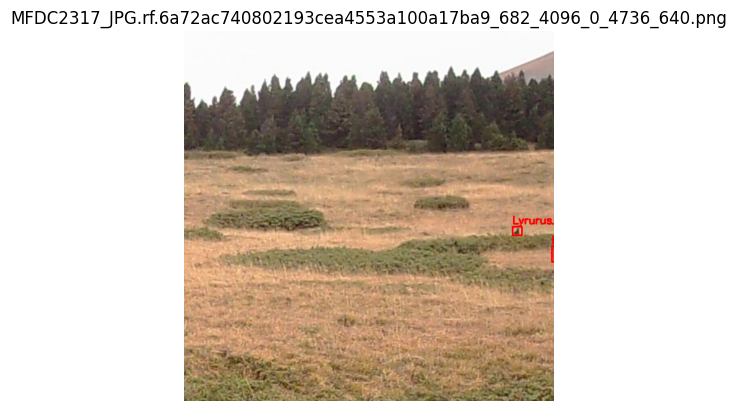

../dataset_sliced/split_1\train\images\MFDC3509_JPG.rf.40a4320376542af9c0db94d8cb7da600_2196_4608_0_5248_640.png
['0', '0.003125', '0.651563', '0.00625', '0.028125']
0.00017578125000000002
4.5


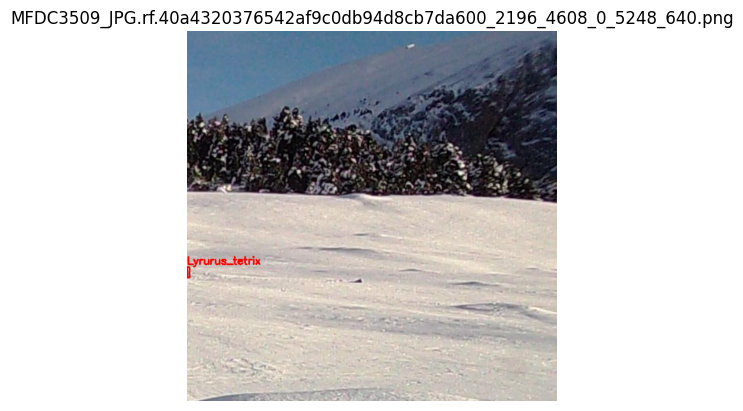

../dataset_sliced/split_1\train\images\MFDC3731_JPG.rf.6f239497673caff6c531968188f54ece_1873_5120_0_5760_640.png
['0', '0.0046875', '0.578906', '0.009375', '0.0359375']
0.0003369140625
3.833333333333333


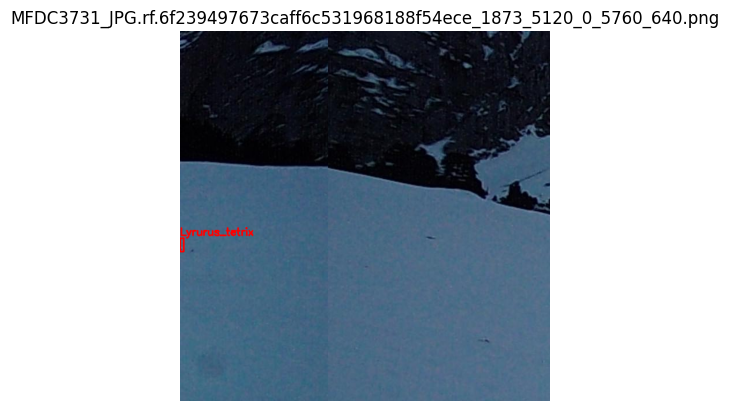

../dataset_sliced/split_1\train\images\MFDC4940_JPG.rf.f1e8fd055cdc5a523d8a6e3706f6a8c2_2181_3584_0_4224_640.png
['0', '0.436719', '0.525', '0.0328125', '0.025']
['0', '0.00625', '0.596875', '0.0125', '0.046875']
0.0005859375000000001
3.75


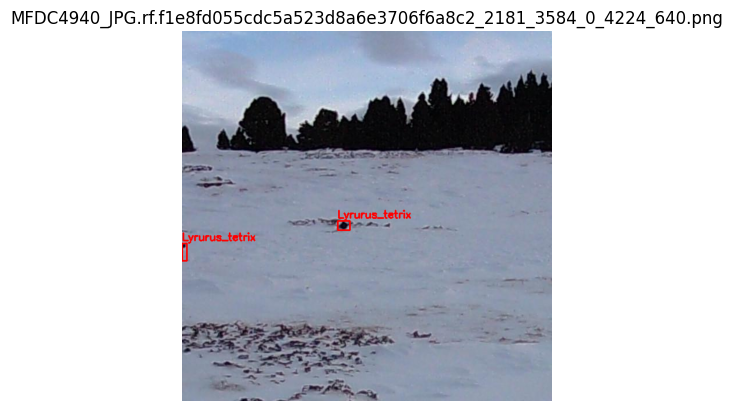

../dataset_sliced/split_1\train\images\MFDC4997_JPG.rf.fffbbc41e1b498dfa60d14a5a2b20cff_126_3584_0_4224_640.png
['0', '0.00703125', '0.589844', '0.0140625', '0.0640625']
0.00090087890625
4.555555555555555


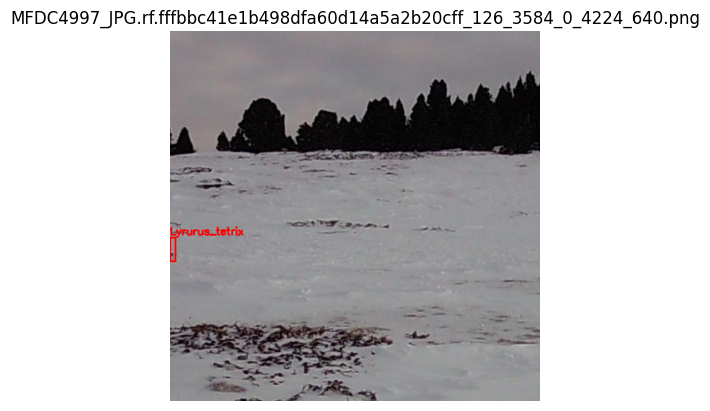

../dataset_sliced/split_1\train\images\MFDC4999_JPG.rf.56c565ab44886176e0b78e181cee8f1e_1050_4608_0_5248_640.png
['0', '0.00546875', '0.545312', '0.0109375', '0.04375']
0.00047851562499999994
4.0


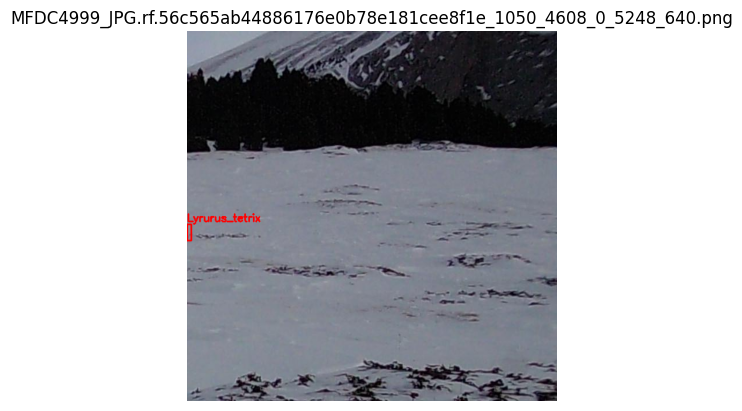

../dataset_sliced/split_1\train\images\MFDC5168_JPG.rf.93d519036dd7d157fc0d72464883ec06_1536_4608_0_5248_640.png
['0', '0.160156', '0.527344', '0.0296875', '0.0203125']
['0', '0.00234375', '0.529687', '0.0046875', '0.021875']
['0', '0.05625', '0.591406', '0.059375', '0.0390625']
0.0001025390625
4.666666666666667


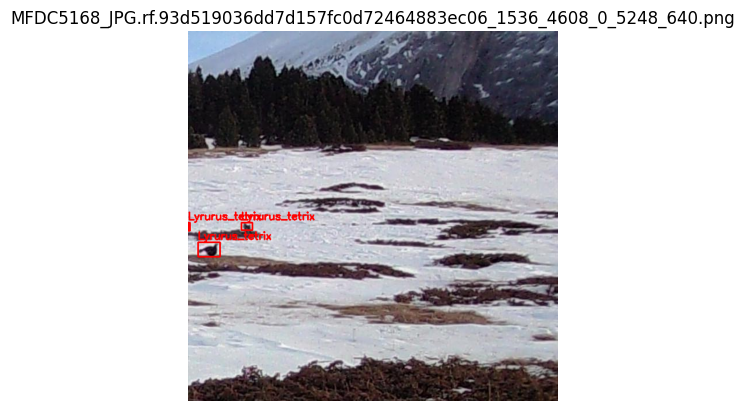

../dataset_sliced/split_1\train\images\MFDC5327_JPG.rf.799b2858c96c13a1616f254d6457392f_449_4096_0_4736_640.png
['0', '0.0046875', '0.609375', '0.009375', '0.040625']
0.000380859375
4.333333333333334


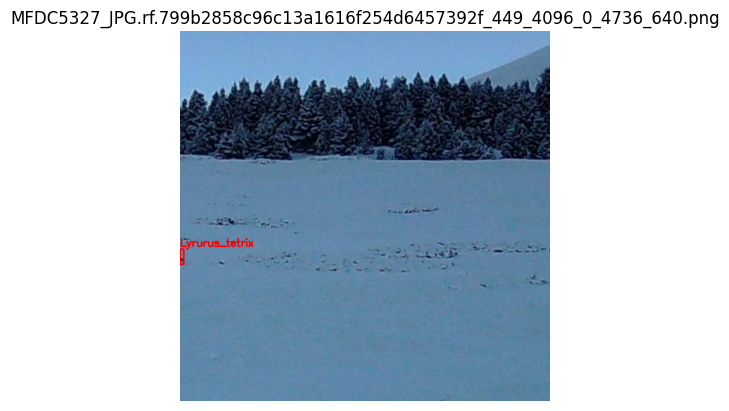

../dataset_sliced/split_1\train\images\MFDC5328_JPG.rf.46488d5857f42b343b95392e7fbe50fa_357_4608_0_5248_640.png
['0', '0.759375', '0.492188', '0.0125', '0.015625']
['0', '0.332031', '0.533594', '0.0203125', '0.0171875']
['0', '0.378125', '0.579688', '0.04375', '0.021875']
['0', '0.00390625', '0.592187', '0.0078125', '0.028125']
['0', '0.89375', '0.632031', '0.046875', '0.0296875']
0.0002197265625
3.6


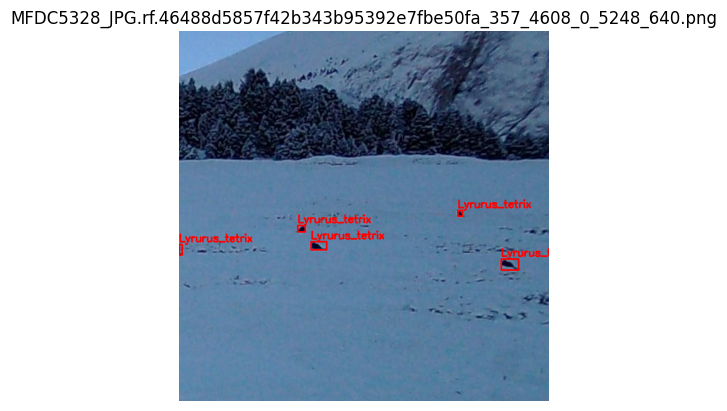

../dataset_sliced/split_1\train\images\MFDC5440_JPG.rf.2f664fbe913a60557be881c14f16572b_2210_3584_0_4224_640.png
['0', '0.996094', '0.616406', '0.0078125', '0.0484375']
0.00037841796875
6.2


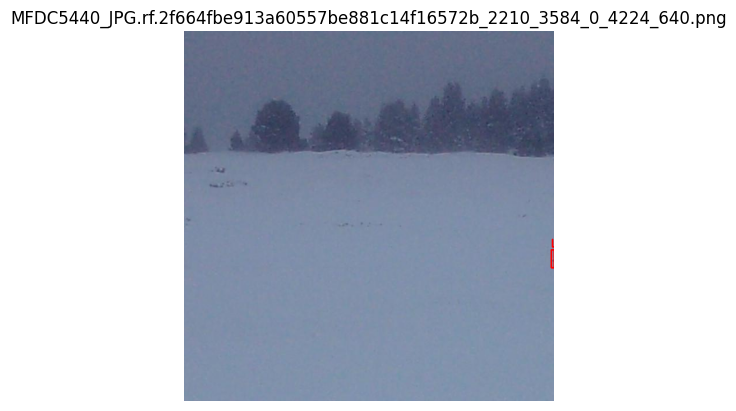

../dataset_sliced/split_1\train\images\MFDC5443_JPG.rf.35d9eb7ec08d2b85e75e18994ee083f7_812_3584_0_4224_640.png
['0', '0.996875', '0.591406', '0.00625', '0.0421875']
['0', '0.926562', '0.598437', '0.05625', '0.05625']
0.000263671875
6.75


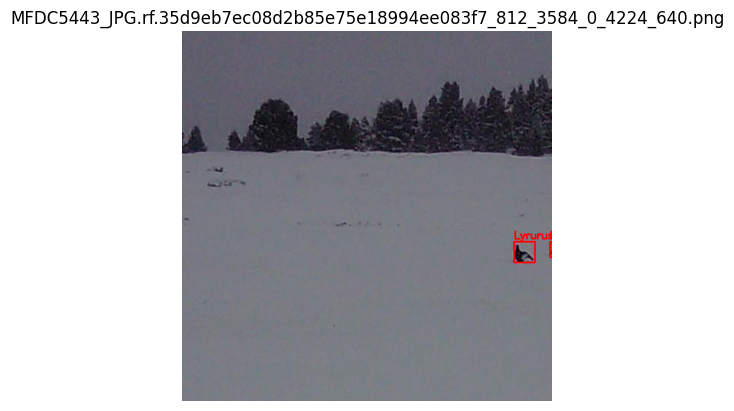

../dataset_sliced/split_1\train\images\MFDC5447_JPG.rf.c526c6302f8af0622f4621fda878e3ac_2346_5120_0_5760_640.png
['0', '0.234375', '0.522656', '0.015625', '0.0171875']
['0', '0.667969', '0.646094', '0.0390625', '0.0234375']
['0', '0.99375', '0.827344', '0.0125', '0.0578125']
0.0007226562500000001
4.625


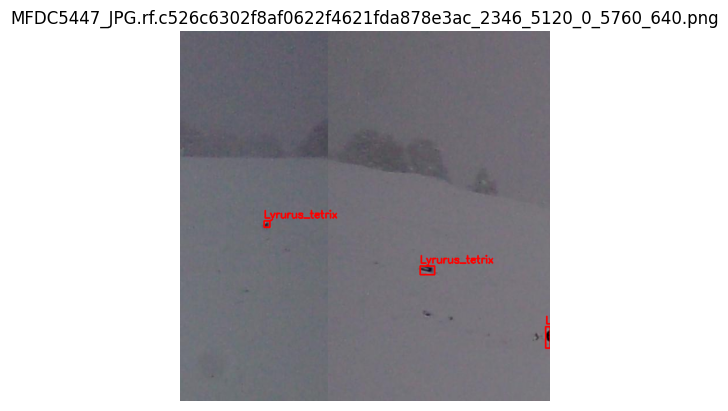

../dataset_sliced/split_1\train\images\MFDC5447_JPG.rf.c526c6302f8af0622f4621fda878e3ac_2346_5120_512_5760_1152.png
['0', '0.99375', '0.028125', '0.0125', '0.05625']
0.0007031250000000001
4.5


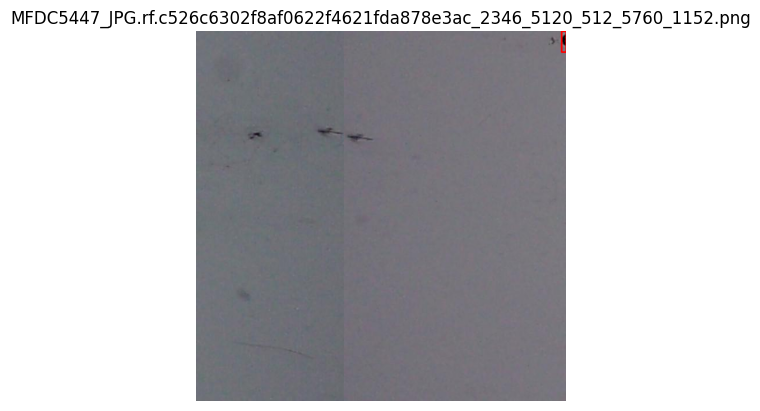

../dataset_sliced/split_1\train\images\MFDC5448_JPG.rf.594d4eba09f1af4a6f62f820586d8b3e_540_5120_0_5760_640.png
['0', '0.124219', '0.521875', '0.0171875', '0.025']
['0', '0.992969', '0.826562', '0.0140625', '0.05']
0.0007031250000000001
3.555555555555556


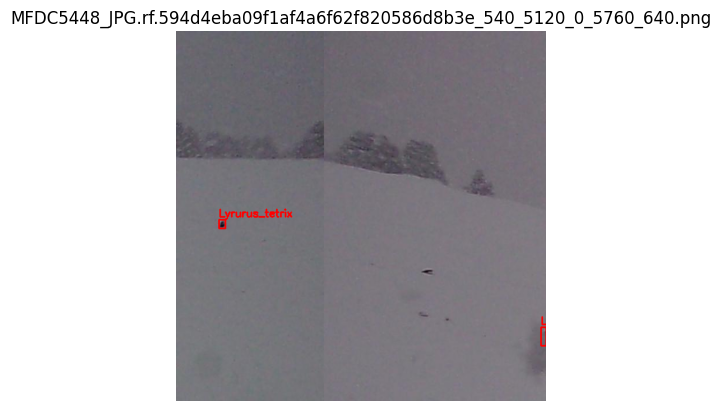

../dataset_sliced/split_1\train\images\MFDC5448_JPG.rf.594d4eba09f1af4a6f62f820586d8b3e_540_5120_512_5760_1152.png
['0', '0.992969', '0.0265625', '0.0140625', '0.05']
0.0007031250000000001
3.555555555555556


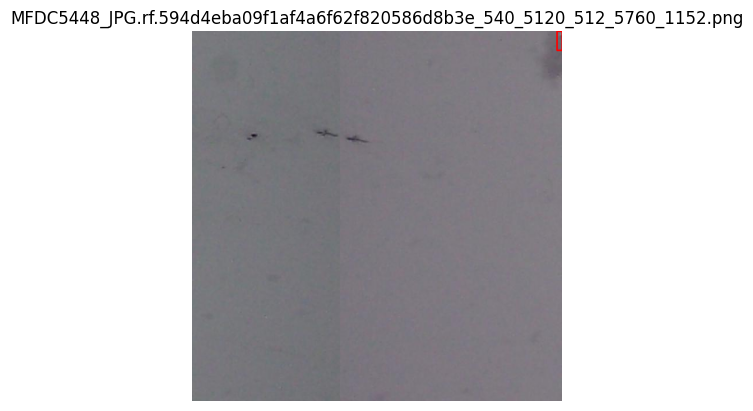

../dataset_sliced/split_1\train\images\MFDC5763_JPG.rf.66d6f4562568980875584b2d903cb35a_1336_4608_0_5248_640.png
['0', '0.401562', '0.547656', '0.021875', '0.0171875']
['0', '0.996875', '0.599219', '0.00625', '0.0265625']
0.000166015625
4.25


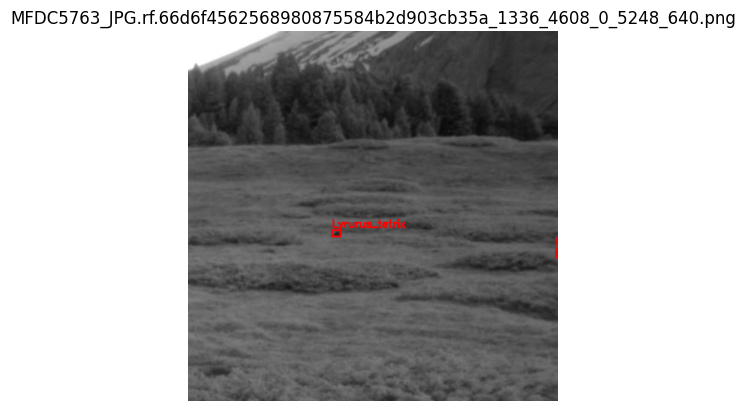

../dataset_sliced/split_1\train\images\MFDC5768_JPG.rf.c97c59d945012c58b0bbf812b401348c_1743_3584_0_4224_640.png
['0', '0.995313', '0.663281', '0.009375', '0.0484375']
0.00045410156249999997
5.166666666666667


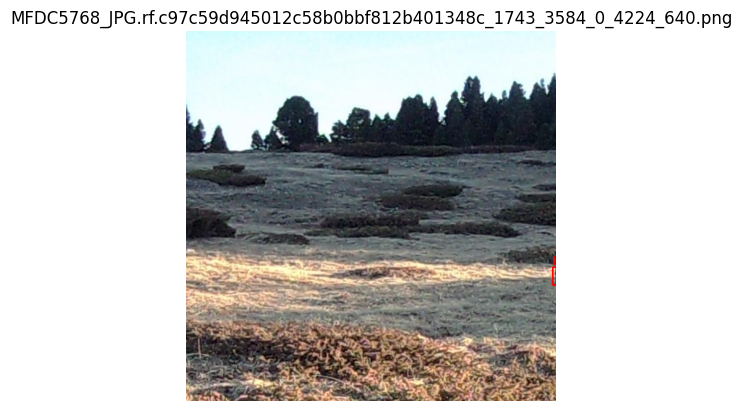

../dataset_sliced/split_1\train\images\MFDC5769_JPG.rf.bdf794891682aef5e3eb86458d0e7c45_984_3584_0_4224_640.png
['0', '0.00703125', '0.5875', '0.0140625', '0.05625']
0.000791015625
4.0


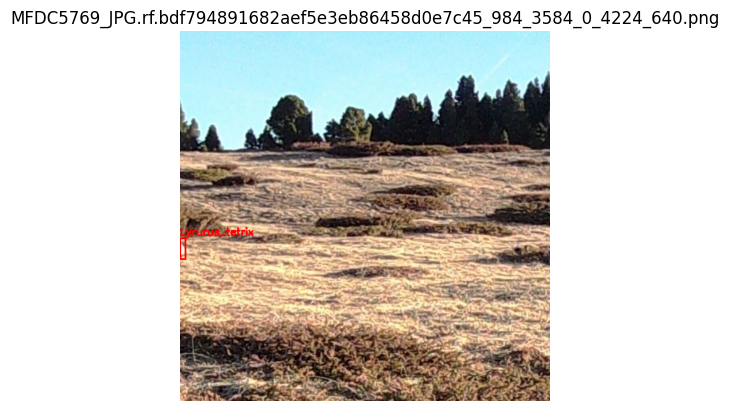

../dataset_sliced/split_1\train\images\MFDC6049_JPG.rf.e3e698175381968764fbba6badc67760_2396_3584_0_4224_640.png
['0', '0.00390625', '0.614844', '0.0078125', '0.0609375']
0.00047607421875
7.8


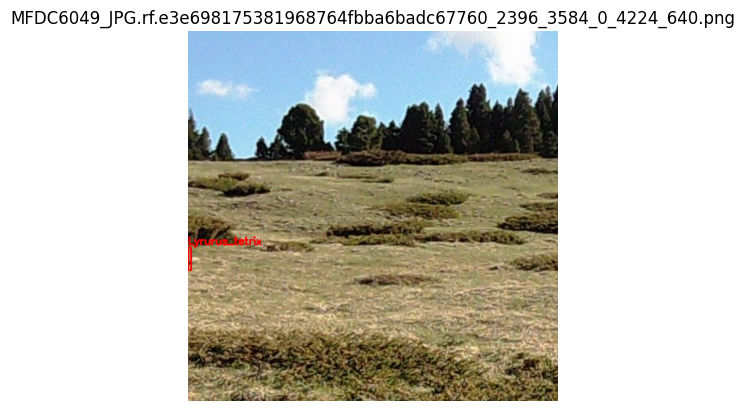

../dataset_sliced/split_1\train\images\MFDC6096_JPG.rf.53d9924875da474f6fecfee977eb62e8_1092_4096_0_4736_640.png
['0', '0.667969', '0.546094', '0.0765625', '0.0484375']
['0', '0.859375', '0.614062', '0.071875', '0.08125']
['0', '0.00390625', '0.675', '0.0078125', '0.071875']
0.0005615234375
9.2


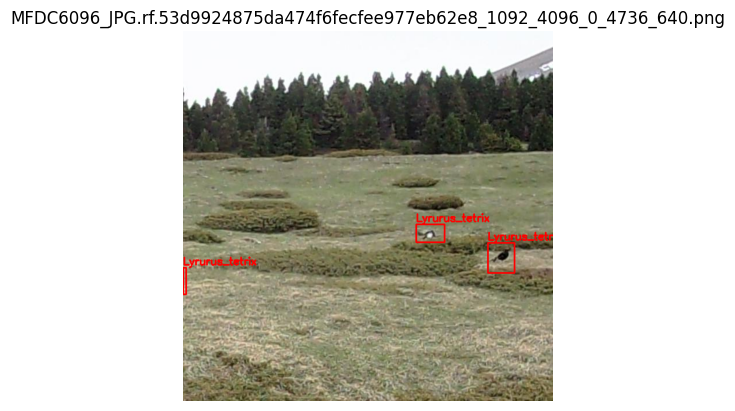

../dataset_sliced/split_1\train\images\MFDC6158_JPG.rf.9fafa38b01bafb884514bbf243a18590_2147_3072_0_3712_640.png
['0', '0.00703125', '0.59375', '0.0140625', '0.075']
0.0010546875
5.333333333333333


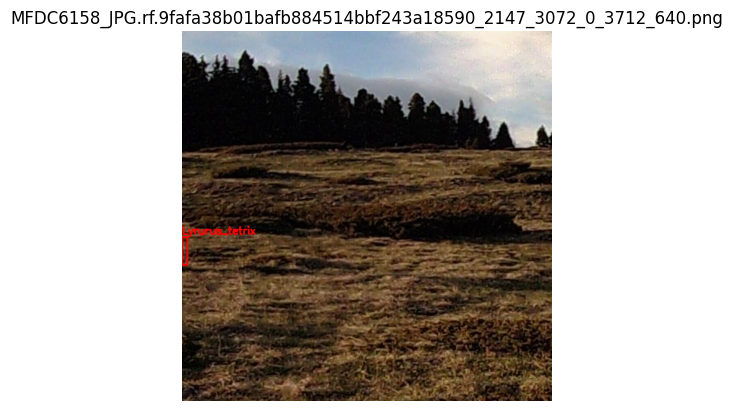

../dataset_sliced/split_1\train\images\MFDC6185_JPG.rf.20ef9c9592d6c485bd5e600fb8ce43ce_199_4096_0_4736_640.png
['0', '0.121875', '0.548438', '0.0375', '0.046875']
['0', '0.992188', '0.610938', '0.015625', '0.059375']
0.000927734375
3.8


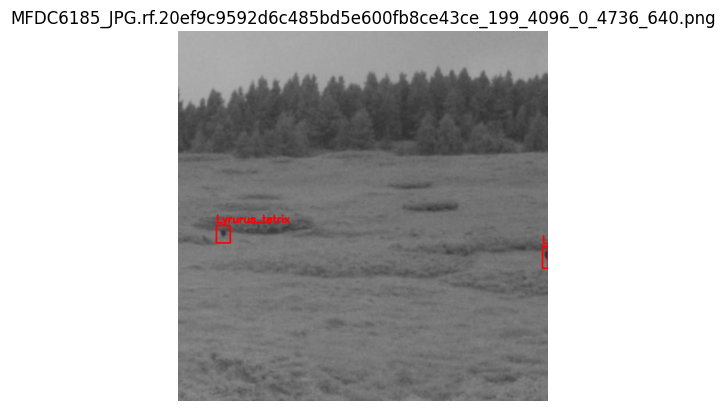

../dataset_sliced/split_1\train\images\MFDC6403_JPG.rf.26731e303331646432e4df2d2e2fd4bb_163_3584_0_4224_640.png
['0', '0.995313', '0.653906', '0.009375', '0.0515625']
0.00048339843749999994
5.5


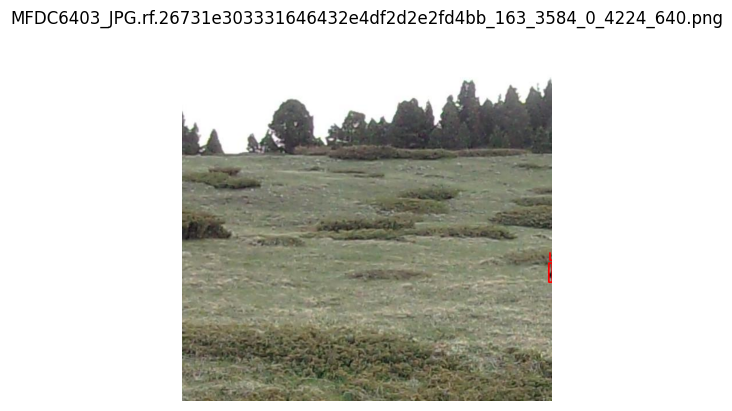

../dataset_sliced/split_1\train\images\MFDC6406_JPG.rf.827b794dbd0646da39729401926490c8_1820_5120_0_5760_640.png
['0', '0.995313', '0.658594', '0.009375', '0.0484375']
0.00045410156249999997
5.166666666666667


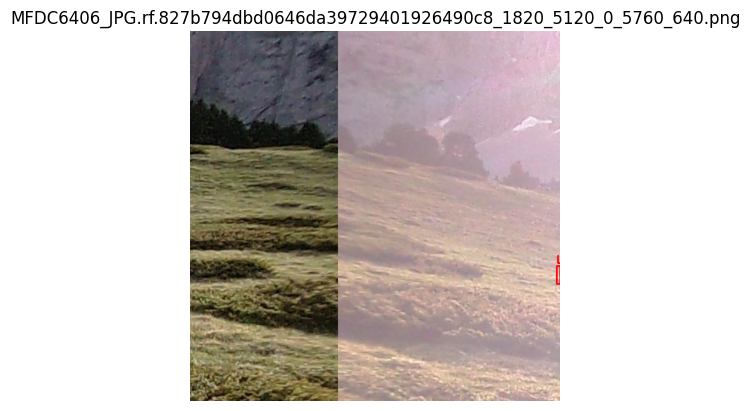

../dataset_sliced/split_1\train\images\MFDC6458_JPG.rf.6c0e5c0678df5a805db0372e7b6b1221_260_3584_0_4224_640.png
['0', '0.99375', '0.679688', '0.0125', '0.046875']
0.0005859375000000001
3.75


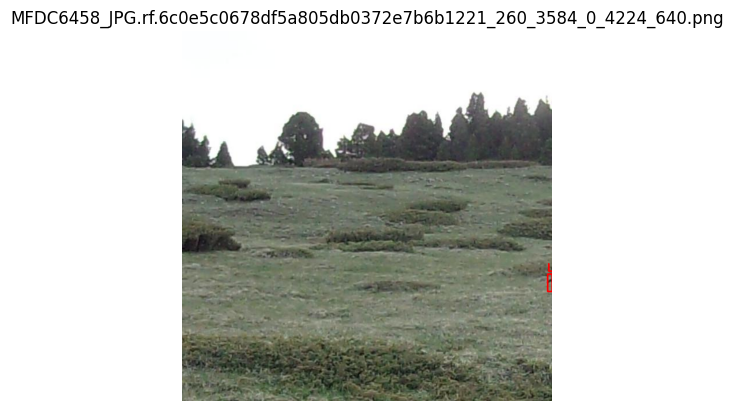

../dataset_sliced/split_1\train\images\MFDC6570_JPG.rf.1ecc44c5031e82d26c6805c8999ffc4f_2209_3584_0_4224_640.png
['0', '0.602344', '0.598437', '0.0671875', '0.046875']
['0', '0.00390625', '0.636719', '0.0078125', '0.0421875']
0.00032958984375
5.4


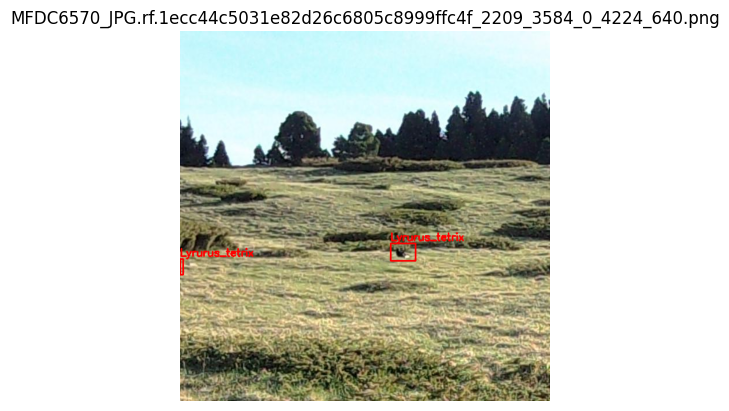

../dataset_sliced/split_1\train\images\MFDC6722_JPG.rf.8943ea364f3ccc5ef7c46128b53ef32a_2223_3584_0_4224_640.png
['0', '0.996094', '0.690625', '0.0078125', '0.0375']
0.00029296875
4.8


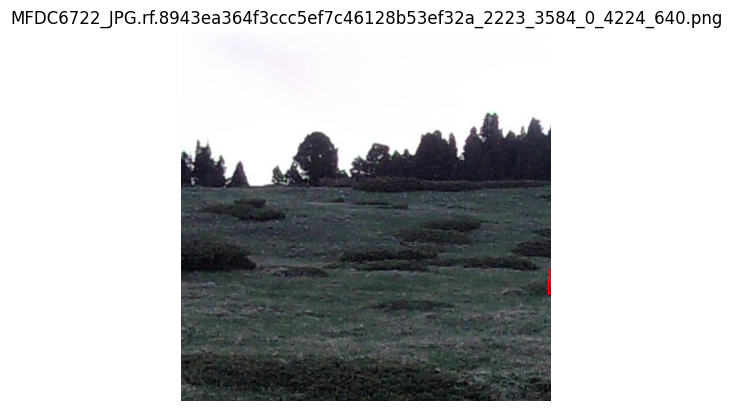

../dataset_sliced/split_1\train\images\MFDC6723_JPG.rf.404f2b8bc4f5dfc9f4ba6c32b8e1a28f_802_3584_0_4224_640.png
['0', '0.992188', '0.719531', '0.015625', '0.0578125']
0.0009033203125
3.7


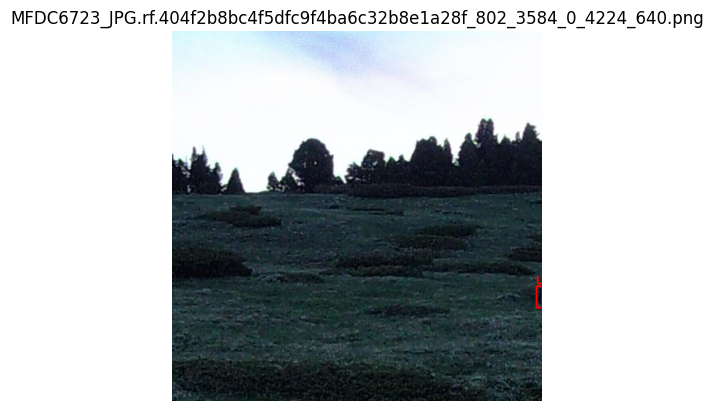

../dataset_sliced/split_1\train\images\MFDC6788_JPG.rf.029ebc49dd6b07728aa85cc6fddb03eb_1669_4096_0_4736_640.png
['0', '0.0046875', '0.565625', '0.009375', '0.040625']
['0', '0.917188', '0.613281', '0.0625', '0.0453125']
0.000380859375
4.333333333333334


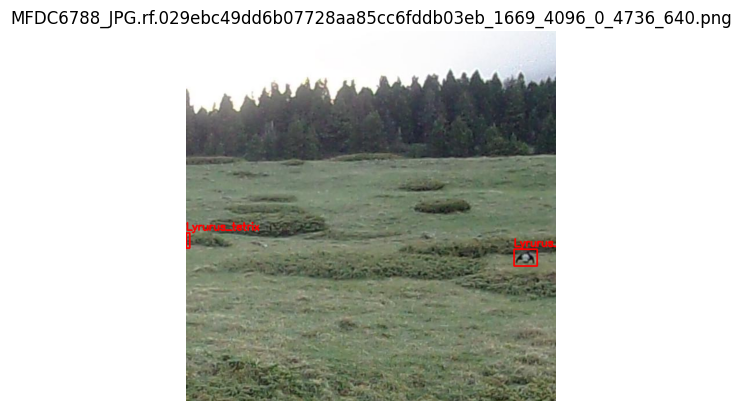

../dataset_sliced/split_1\train\images\MFDC6841_JPG.rf.c5b9af5086d18ddf74416dec3a2e50ff_2479_3584_0_4224_640.png
['0', '0.911719', '0.55', '0.0390625', '0.028125']
['0', '0.995313', '0.672656', '0.009375', '0.0453125']
0.0004248046875
4.833333333333333


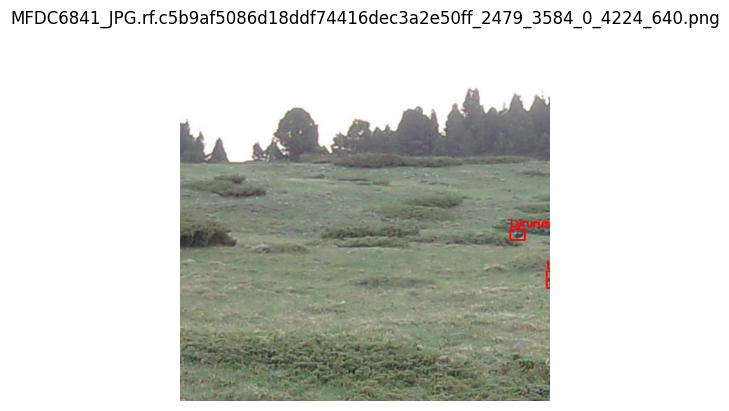

../dataset_sliced/split_1\train\images\MFDC7027_JPG.rf.c657a1af0b31ed428302dcca4a10f991_1397_3072_0_3712_640.png
['0', '0.00546875', '0.632812', '0.0109375', '0.065625']
['0', '0.894531', '0.635156', '0.0859375', '0.0453125']
0.0007177734375
6.000000000000001


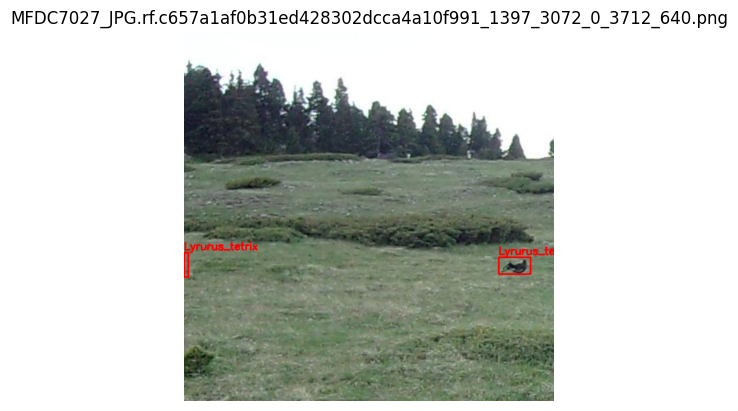

../dataset_sliced/split_1\train\images\MFDC7089_JPG.rf.7707956e5d7489e789887340b114780a_998_3072_0_3712_640.png
['0', '0.00625', '0.625', '0.0125', '0.059375']
0.0007421875
4.749999999999999


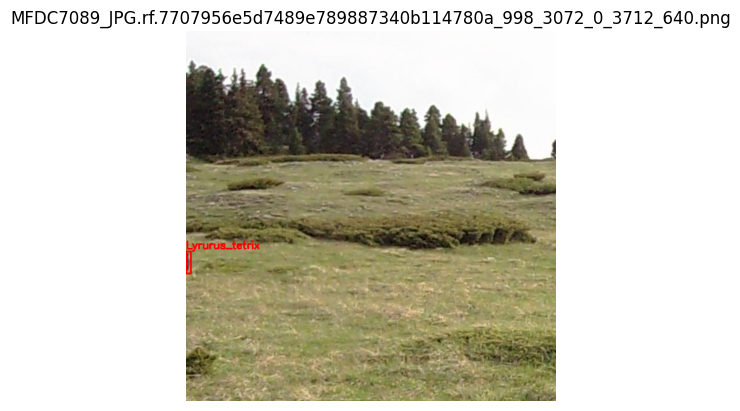

../dataset_sliced/split_1\train\images\MFDC7186_JPG.rf.9bbb86de0cb863f3e703454e9d054f44_1105_4608_0_5248_640.png
['0', '0.309375', '0.491406', '0.028125', '0.0296875']
['0', '0.996875', '0.635938', '0.00625', '0.04375']
0.00027343749999999997
6.999999999999999


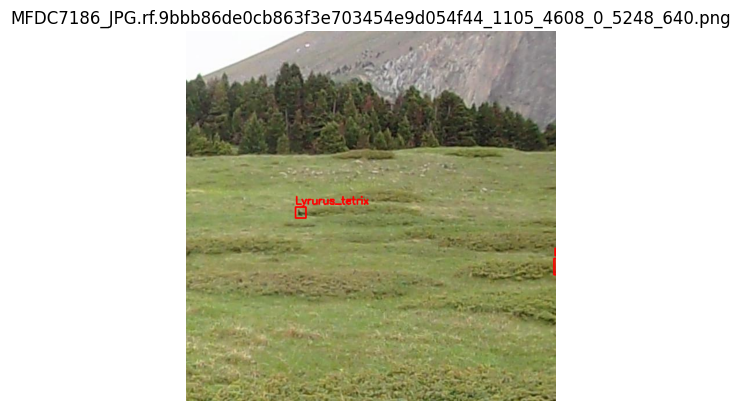

../dataset_sliced/split_1\train\images\MFDC7238_JPG.rf.49fb451ef201f9824bd5351a1fa11069_2374_2560_512_3200_1152.png
['0', '0.00859375', '0.719531', '0.0171875', '0.132812']
0.0022827062500000005
7.727243636363636


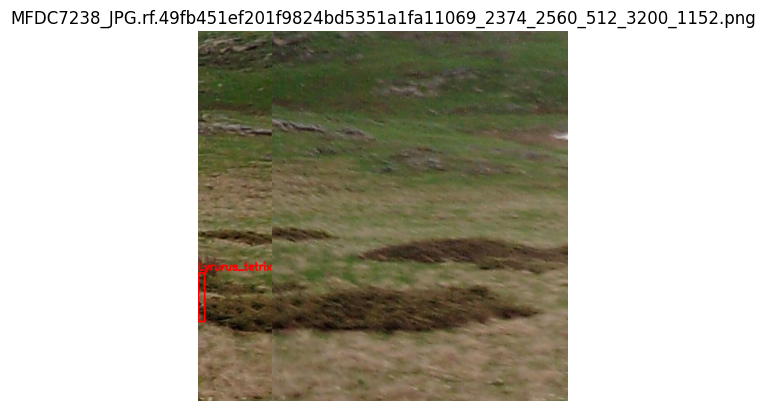

../dataset_sliced/split_1\train\images\MFDC7238_JPG.rf.49fb451ef201f9824bd5351a1fa11069_2374_2560_872_3200_1512.png
['0', '0.00859375', '0.157031', '0.0171875', '0.132812']
0.0022827062500000005
7.727243636363636


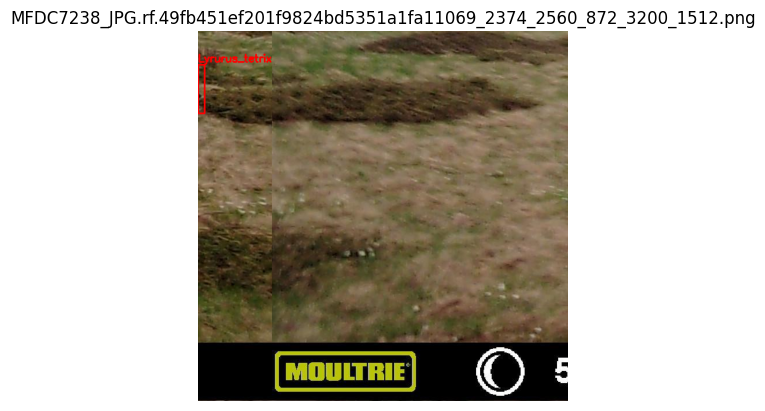

../dataset_sliced/split_1\train\images\MFDC7255_JPG.rf.c68e1e6a156534cdc1fbb0e2dc5529ff_1163_4096_0_4736_640.png
['0', '0.126562', '0.551562', '0.01875', '0.03125']
['0', '0.989844', '0.594531', '0.0203125', '0.0390625']
['0', '0.0046875', '0.652344', '0.009375', '0.0328125']
0.0003076171875
3.5000000000000004


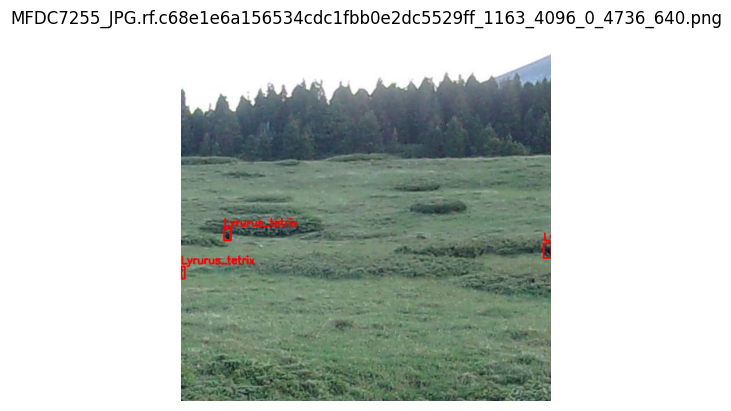

../dataset_sliced/split_1\train\images\MFDC7542_JPG.rf.6ed9d9cc1cd2a7d4946b1c39e0434bac_2409_4096_0_4736_640.png
['0', '0.00234375', '0.538281', '0.0046875', '0.0265625']
['0', '0.621094', '0.663281', '0.0640625', '0.0453125']
0.00012451171875
5.666666666666667


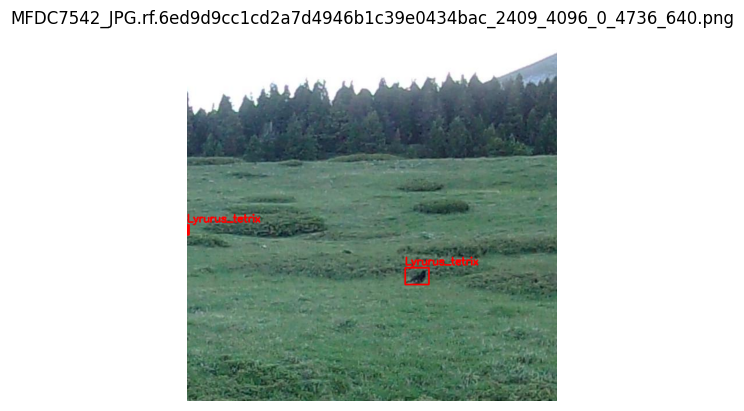

../dataset_sliced/split_1\train\images\MFDC7602_JPG.rf.3881f90618f5ec0010f301411181365b_967_5120_0_5760_640.png
['0', '0.975', '0.669531', '0.040625', '0.0296875']
['0', '0.996875', '0.703125', '0.00625', '0.03125']
0.0001953125
5.0


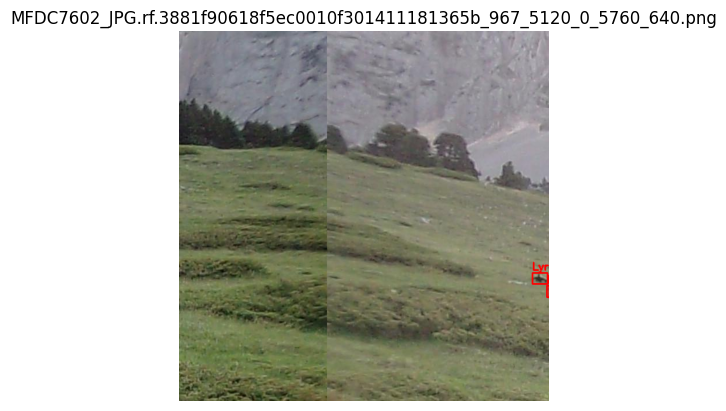

../dataset_sliced/split_1\train\images\MFDC7660_JPG.rf.7d859cdd5a4f09d02236f1d71aa62e9e_1018_3072_0_3712_640.png
['0', '0.00625', '0.535156', '0.0125', '0.0453125']
['0', '0.509375', '0.595313', '0.065625', '0.05625']
['0', '0.594531', '0.597656', '0.0515625', '0.0515625']
['0', '0.746094', '0.625781', '0.0671875', '0.0359375']
0.00056640625
3.6249999999999996


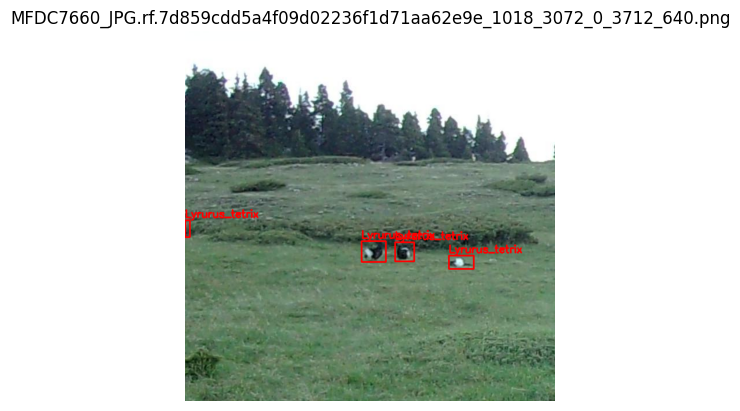

../dataset_sliced/split_1\train\images\MFDC7886_JPG.rf.524657c25e5d0eaa3c225f4a63abb12f_400_3584_0_4224_640.png
['0', '0.914062', '0.553125', '0.028125', '0.021875']
['0', '0.996875', '0.596875', '0.00625', '0.034375']
['0', '0.971094', '0.676562', '0.0578125', '0.059375']
0.00021484375000000003
5.5


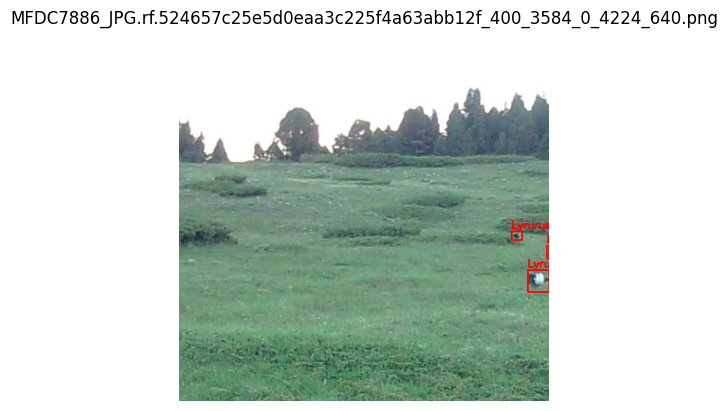

../dataset_sliced/split_1\train\images\MFDC8519_JPG.rf.71c869b0805665fdf87b700a30bccbfa_676_3584_0_4224_640.png
['0', '0.00234375', '0.628906', '0.0046875', '0.0640625']
0.00030029296874999994
13.666666666666666


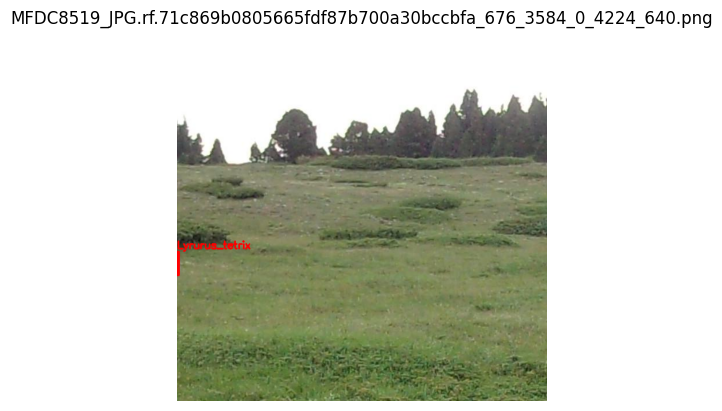

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-10-_JPG.rf.52c96c3dd0195c715877bfed65763027_1382_1952_0_2592_640.png
['0', '0.009375', '0.929688', '0.01875', '0.1125']
0.002109375
6.0


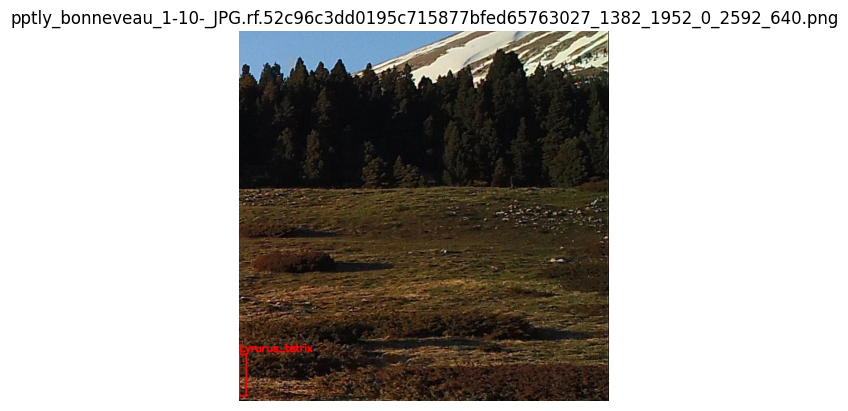

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-10-_JPG.rf.52c96c3dd0195c715877bfed65763027_1382_1952_512_2592_1152.png
['0', '0.009375', '0.129688', '0.01875', '0.1125']
0.002109375
6.0


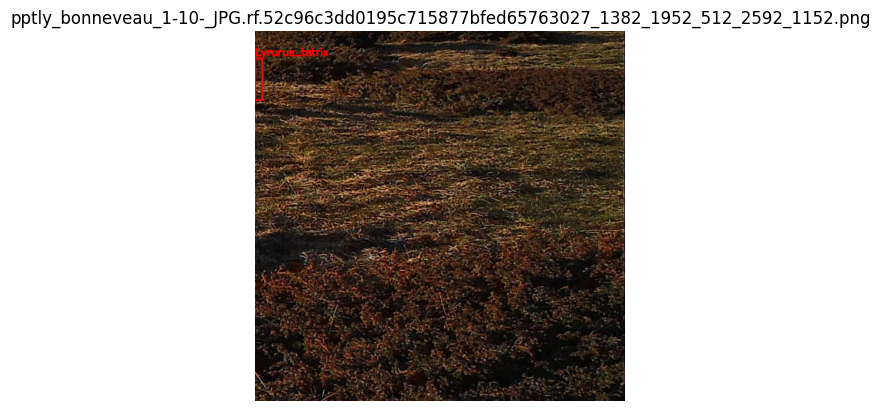

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-121-_JPG.rf.42d58c9609bbeb949668f8641291a064_478_1024_0_1664_640.png
['0', '0.992969', '0.854688', '0.0140625', '0.05']
0.0007031250000000001
3.555555555555556


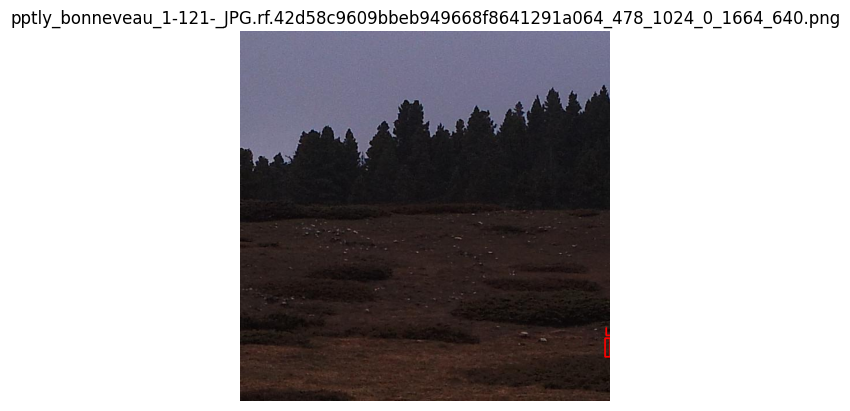

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-121-_JPG.rf.42d58c9609bbeb949668f8641291a064_478_1024_512_1664_1152.png
['0', '0.992969', '0.0546875', '0.0140625', '0.05']
0.0007031250000000001
3.555555555555556


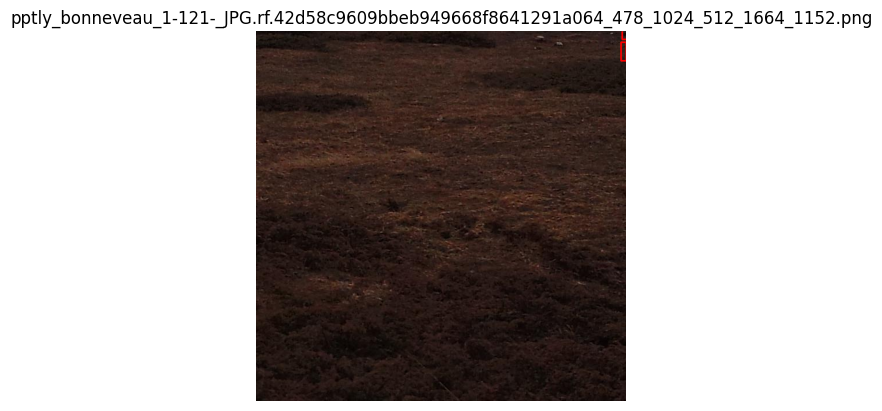

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-194-_JPG.rf.58f405be3ed4ed1bcd6d58fd5223b71e_89_512_512_1152_1152.png
['0', '0.0203125', '0.314063', '0.040625', '0.1625']
0.006601562500000001
4.0


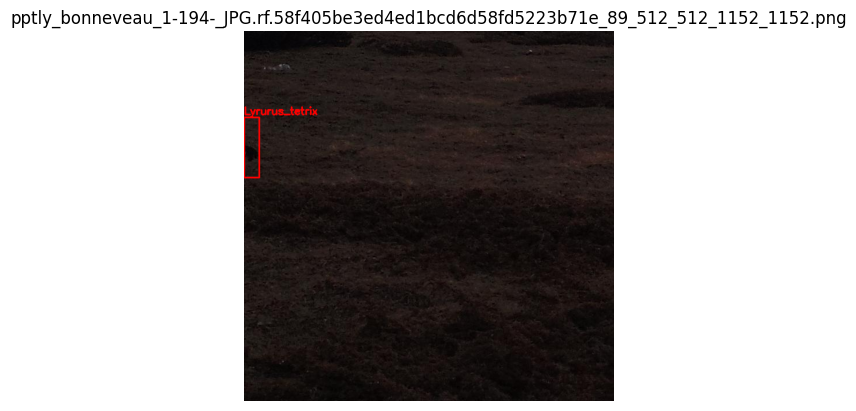

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-204-_JPG.rf.785b1489a4416d7f2fb4c050b94d5615_744_1024_512_1664_1152.png
['0', '0.799219', '0.132812', '0.0890625', '0.078125']
['0', '0.015625', '0.383594', '0.03125', '0.110937']
0.00346678125
3.549984


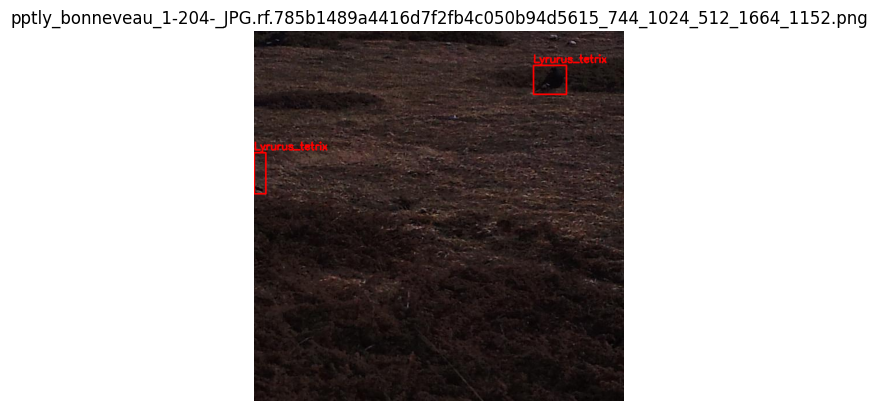

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-205-_JPG.rf.938aeaa59a5d08a02eeadc87a8eeb99a_1393_1024_512_1664_1152.png
['0', '0.797656', '0.128906', '0.0859375', '0.0671875']
['0', '0.0125', '0.382812', '0.025', '0.103125']
0.002578125
4.124999999999999


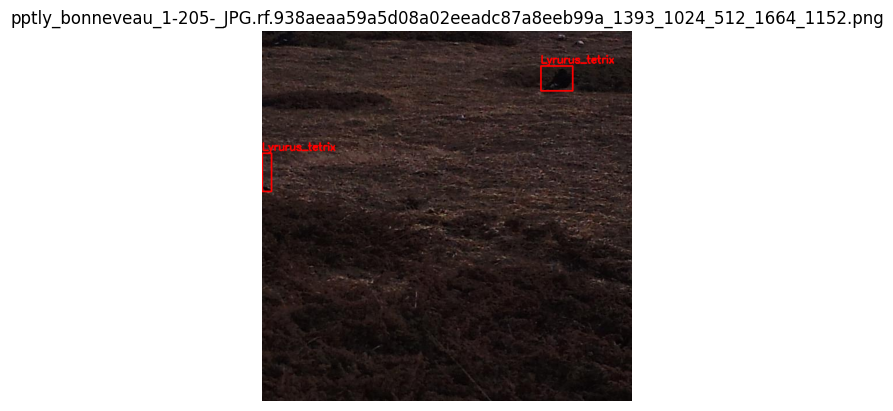

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-239-_JPG.rf.fccf90c0c61c0aa6707d2436e10fe95a_386_0_0_640_640.png
['0', '0.992969', '0.959375', '0.0140625', '0.08125']
0.0011425781250000001
5.777777777777778


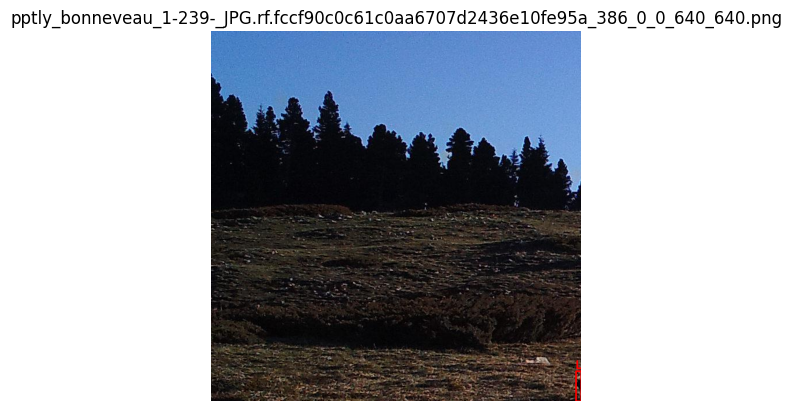

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-250-_JPG.rf.7b7363d75245cc08530d7e0c13b114e6_1_0_0_640_640.png
['0', '0.990625', '0.890625', '0.01875', '0.084375']
0.00158203125
4.500000000000001


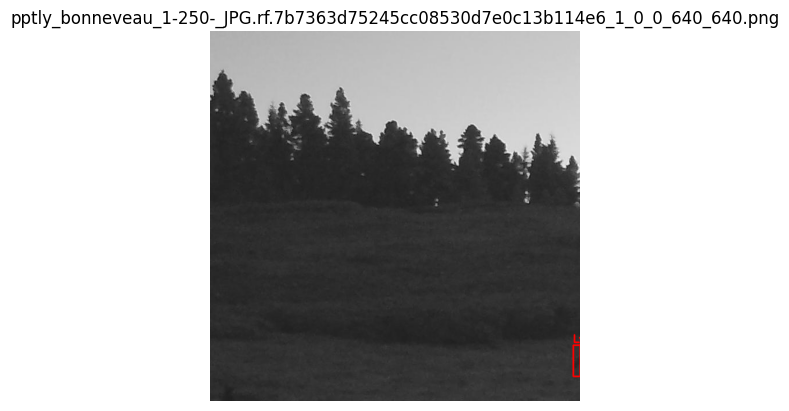

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-250-_JPG.rf.7b7363d75245cc08530d7e0c13b114e6_1_0_512_640_1152.png
['0', '0.990625', '0.090625', '0.01875', '0.084375']
0.00158203125
4.500000000000001


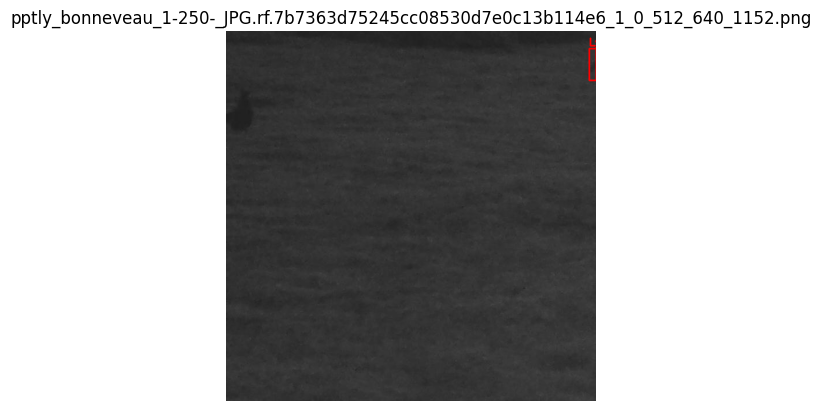

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-256-_JPG.rf.1b77d2ce030da6feab1abd6341167ee4_60_1536_0_2176_640.png
['0', '0.00390625', '0.76875', '0.0078125', '0.0375']
['0', '0.778125', '0.975781', '0.10625', '0.0484375']
['0', '0.927344', '0.990625', '0.114062', '0.01875']
0.00029296875
4.8


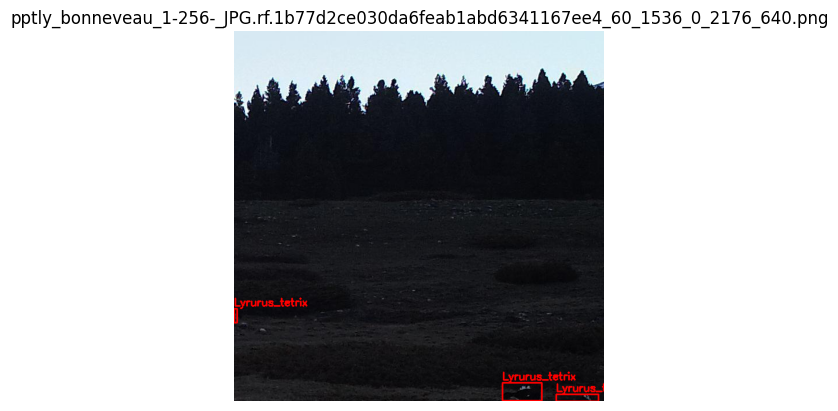

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-270-_JPG.rf.63d8b6d3b690d3e75640b2e90b89ce06_2474_1952_512_2592_1152.png
['0', '0.0078125', '0.146875', '0.015625', '0.06875']
0.00107421875
4.4


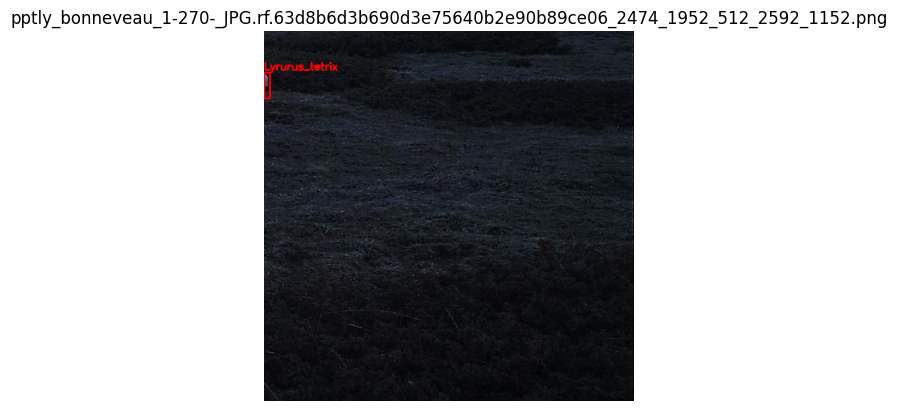

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-271-_JPG.rf.9aa08eb3b9c8dfc45a81318423c5b7a5_1083_1952_0_2592_640.png
['0', '0.009375', '0.948438', '0.01875', '0.065625']
0.00123046875
3.5000000000000004


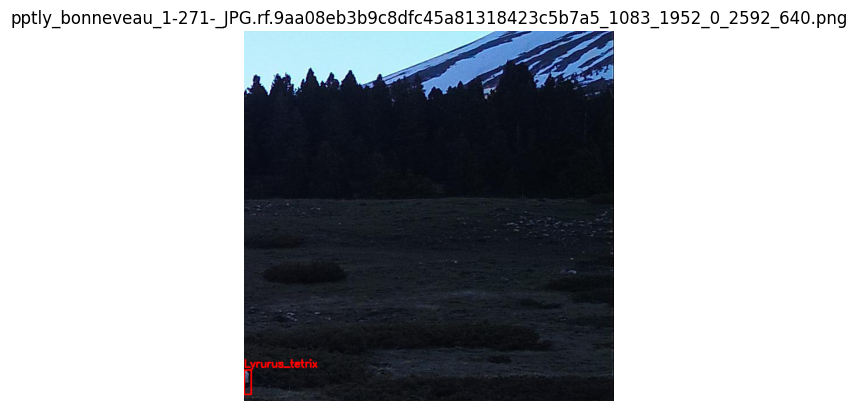

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-271-_JPG.rf.9aa08eb3b9c8dfc45a81318423c5b7a5_1083_1952_512_2592_1152.png
['0', '0.009375', '0.148438', '0.01875', '0.065625']
0.00123046875
3.5000000000000004


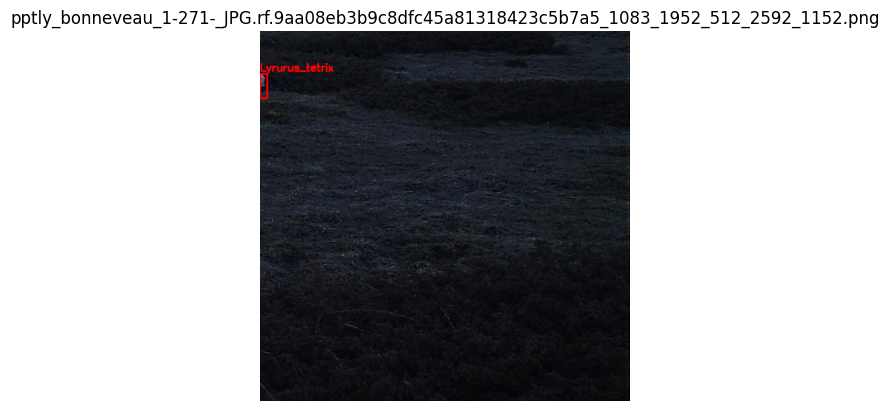

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-306-_JPG.rf.9cd88ec9ba12d629f95b7b84a3ebc9b1_1790_1536_512_2176_1152.png
['0', '0.301563', '0.114062', '0.04375', '0.04375']
['0', '0.99375', '0.215625', '0.0125', '0.06875']
0.0008593750000000001
5.5


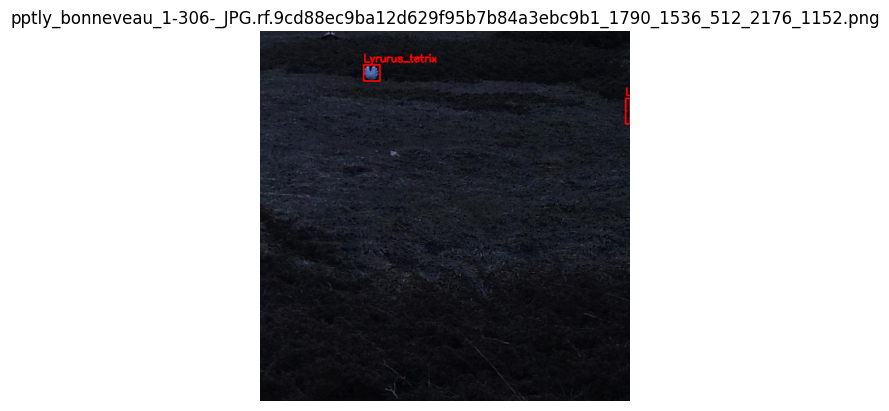

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-32-_JPG.rf.12e7d8e20b27fe1f9ef69b33149d3e11_365_1952_0_2592_640.png
['0', '0.00859375', '0.925781', '0.0171875', '0.0640625']
0.00110107421875
3.7272727272727266


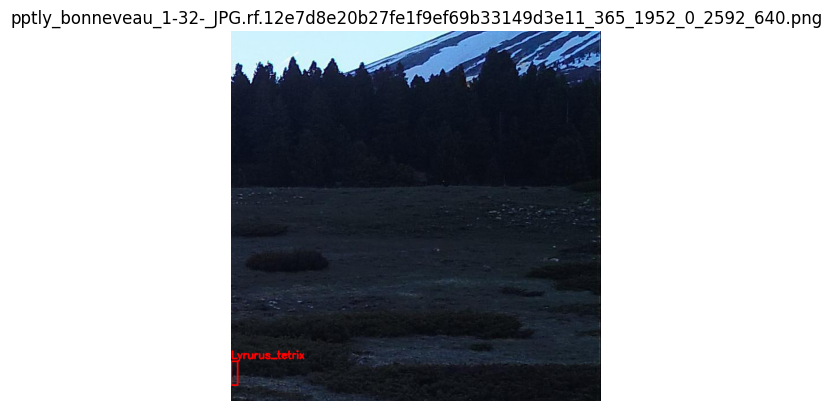

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-33-_JPG.rf.df11af6f3a84290f607f2fb1b4e161c2_1342_1952_512_2592_1152.png
['0', '0.00859375', '0.126562', '0.0171875', '0.065625']
0.0011279296875000002
3.818181818181818


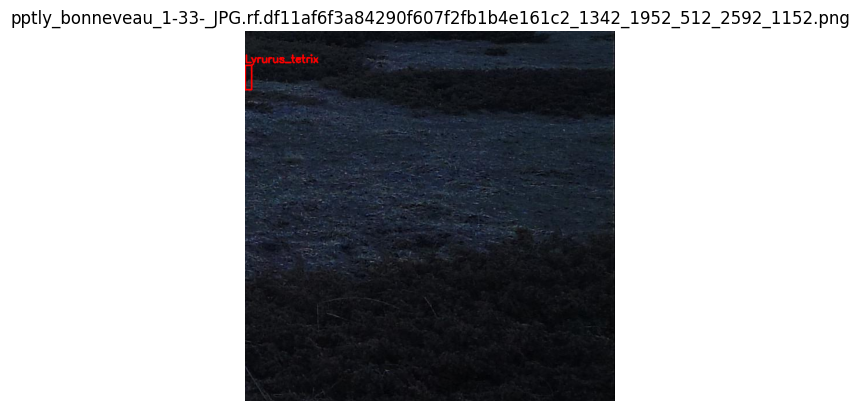

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-34-_JPG.rf.511568692525ba43794251354272c3bb_1084_1952_0_2592_640.png
['0', '0.00546875', '0.925', '0.0109375', '0.065625']
0.0007177734375
6.000000000000001


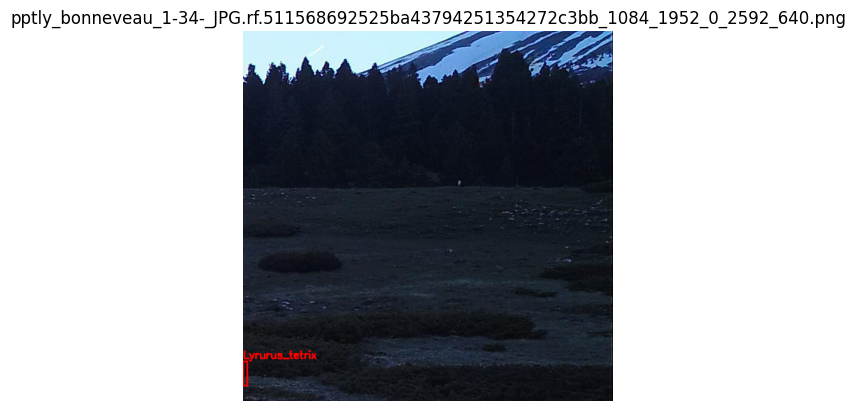

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-34-_JPG.rf.511568692525ba43794251354272c3bb_1084_1952_512_2592_1152.png
['0', '0.00546875', '0.125', '0.0109375', '0.065625']
0.0007177734375
6.000000000000001


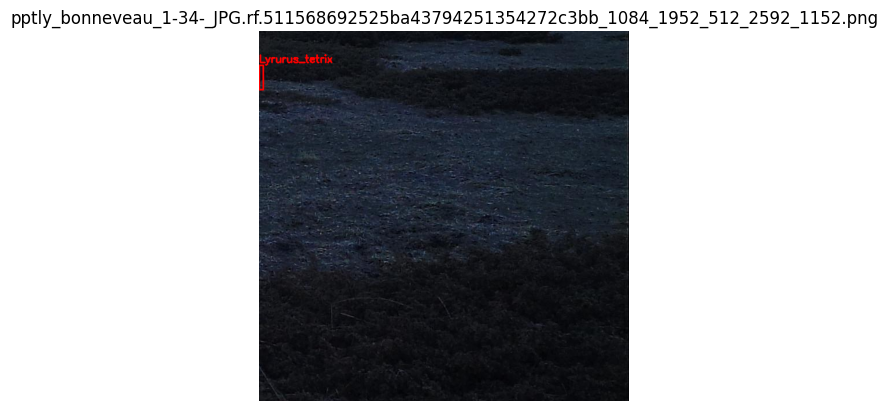

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-55-_jpg.rf.1a829455bf32e571eccb84d8202e9ff8_1495_1024_0_1664_640.png
['0', '0.995313', '0.85', '0.009375', '0.059375']
['0', '0.763281', '0.944531', '0.0640625', '0.0890625']
0.000556640625
6.333333333333333


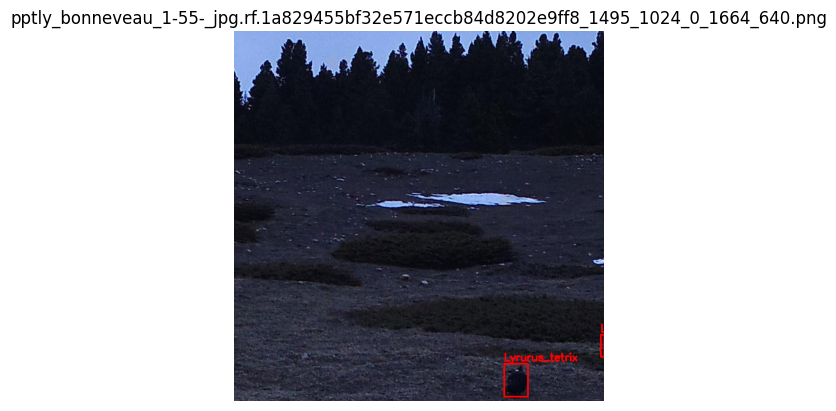

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-55-_jpg.rf.1a829455bf32e571eccb84d8202e9ff8_1495_1024_512_1664_1152.png
['0', '0.995313', '0.05', '0.009375', '0.059375']
['0', '0.763281', '0.144531', '0.0640625', '0.0890625']
0.000556640625
6.333333333333333


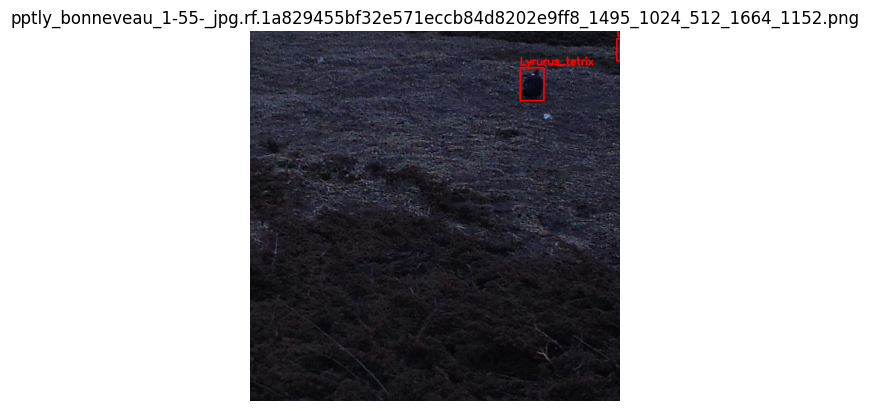

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-71-_jpg.rf.b6bf2b0708e362aa6c3963b38fdc07c7_2406_1536_0_2176_640.png
['0', '0.0132812', '0.947656', '0.0265625', '0.104688']
0.002780775
3.941195294117647


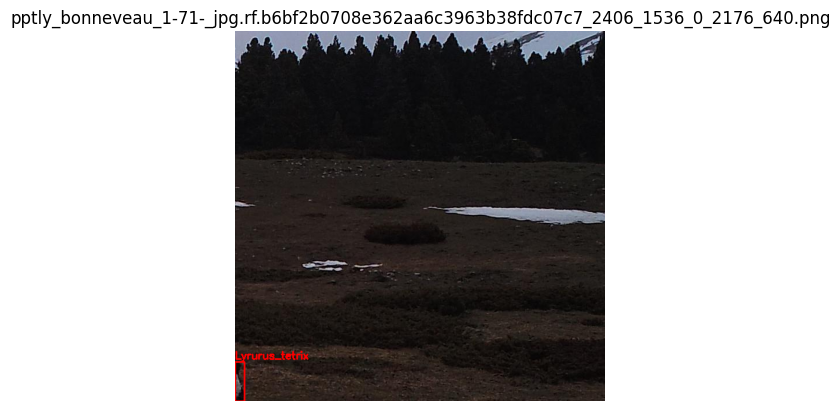

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-71-_jpg.rf.b6bf2b0708e362aa6c3963b38fdc07c7_2406_1536_512_2176_1152.png
['0', '0.0132812', '0.167187', '0.0265625', '0.14375']
0.0038183593749999997
5.411764705882352


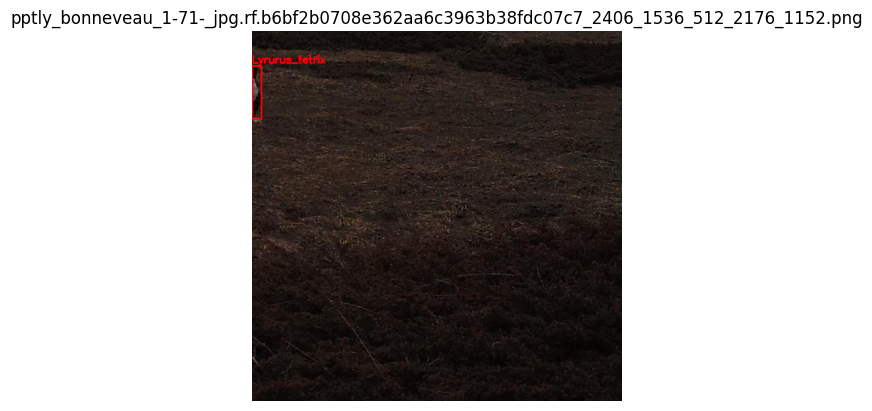

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-99-_JPG.rf.93031cb7aab83914a666aae07a389462_1501_512_0_1152_640.png
['0', '0.99375', '0.847656', '0.0125', '0.0484375']
['0', '0.81875', '0.940625', '0.10625', '0.059375']
0.0006054687500000001
3.875


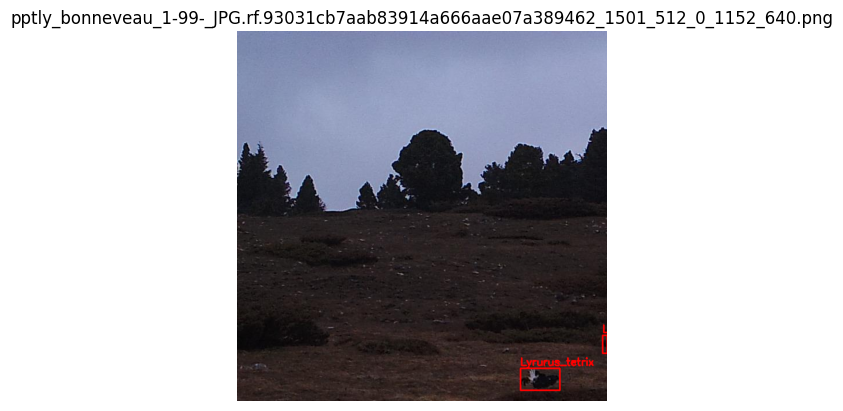

../dataset_sliced/split_1\train\images\pptly_bonneveau_1-99-_JPG.rf.93031cb7aab83914a666aae07a389462_1501_512_512_1152_1152.png
['0', '0.99375', '0.0476562', '0.0125', '0.0484375']
['0', '0.81875', '0.140625', '0.10625', '0.059375']
0.0006054687500000001
3.875


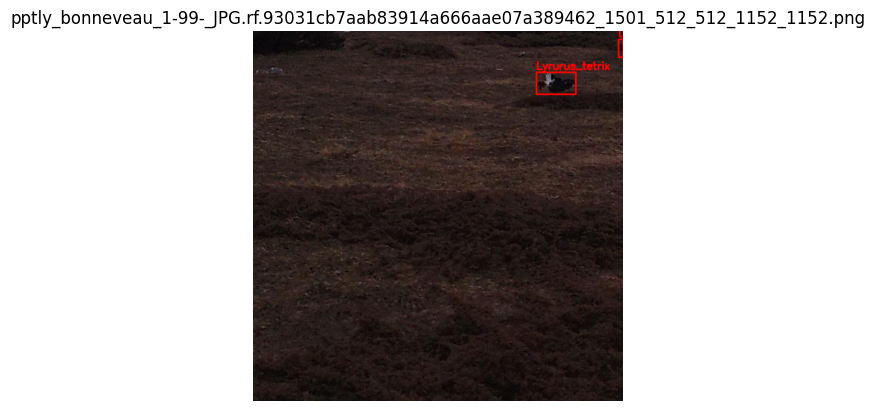

../dataset_sliced/split_1\val\images\04210192_JPG.rf.aabd0cb4a4d8e657c74bda328275319b_1784_1952_512_2592_1152.png
['0', '0.0179687', '0.380469', '0.0359375', '0.132812']
['0', '0.128906', '0.40625', '0.126562', '0.109375']
0.00477293125
3.6956382608695657


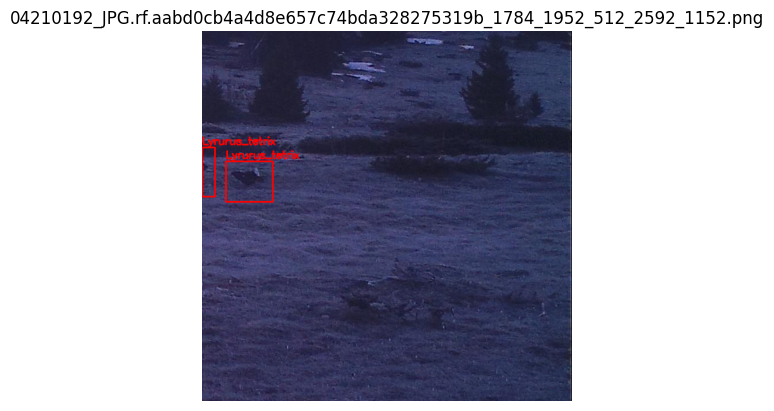

../dataset_sliced/split_1\val\images\04210198_JPG.rf.981277ebed165a25052311fac5158dcd_1108_1536_512_2176_1152.png
['0', '0.0078125', '0.360156', '0.015625', '0.107813']
0.001684578125
6.900032


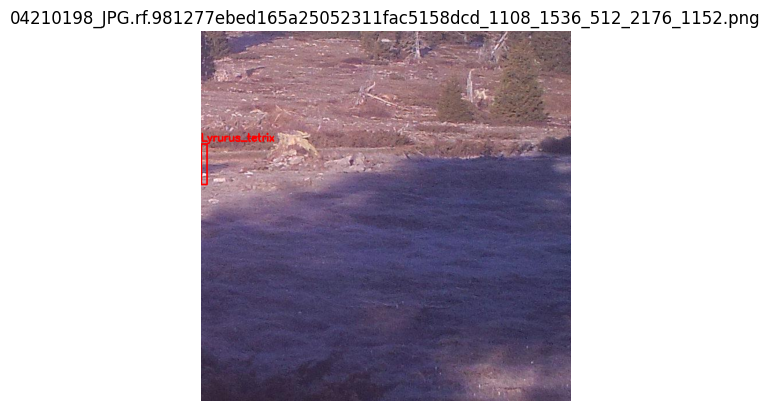

../dataset_sliced/split_1\val\images\04230275_JPG.rf.c63511735ef079f1f8e9646240f948ee_1254_1952_512_2592_1152.png
['0', '0.009375', '0.399219', '0.01875', '0.0859375']
0.001611328125
4.583333333333334


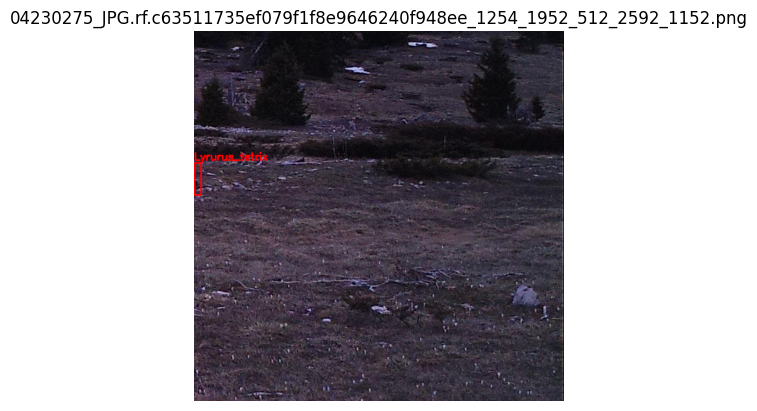

../dataset_sliced/split_1\val\images\04240320_JPG.rf.5882aff58543f37248eb62172bdb258f_1702_1024_512_1664_1152.png
['0', '0.00703125', '0.467187', '0.0140625', '0.065625']
0.0009228515625000001
4.666666666666667


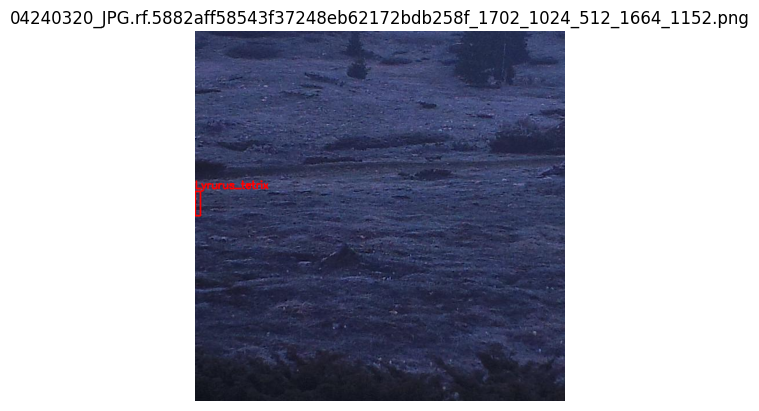

../dataset_sliced/split_1\val\images\05010022_JPG.rf.2204dd491c7e35d3d32d5d2e0bd2c149_1387_1536_0_2176_640.png
['0', '0.753125', '0.226562', '0.121875', '0.071875']
['0', '0.985938', '0.277344', '0.028125', '0.101562']
0.00285643125
3.6110933333333333


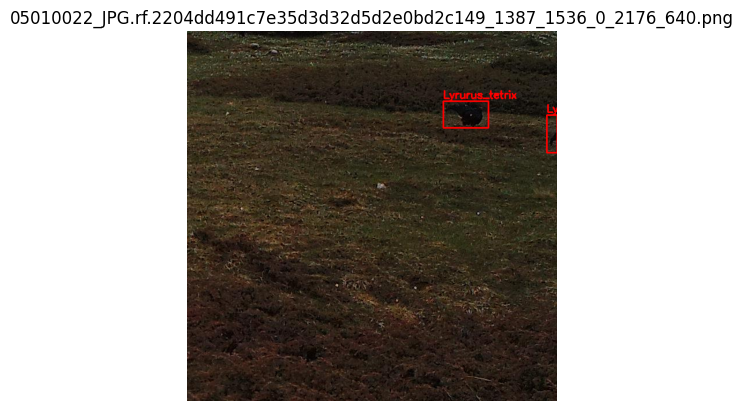

../dataset_sliced/split_1\val\images\05020213_JPG.rf.db41d9e24935bad867078a7fd250a4e4_740_512_512_1152_1152.png
['0', '0.00546875', '0.403906', '0.0109375', '0.0609375']
0.00066650390625
5.571428571428572


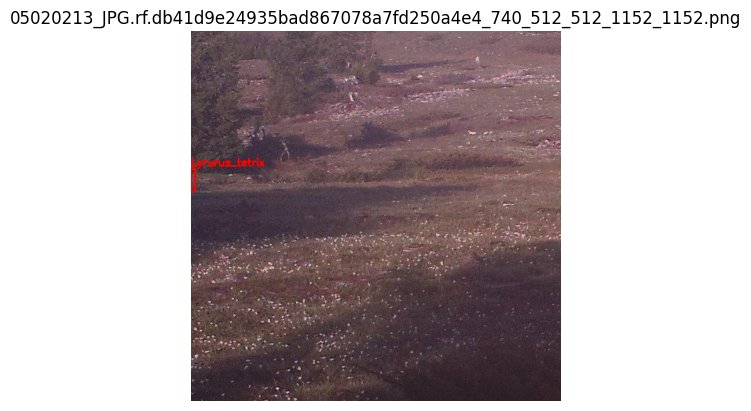

../dataset_sliced/split_1\val\images\05030085_JPG.rf.0faa37df1a120a8ef2966cdc5f1746e5_1785_1536_0_2176_640.png
['0', '0.985938', '0.228125', '0.028125', '0.121875']
0.003427734375
4.333333333333333


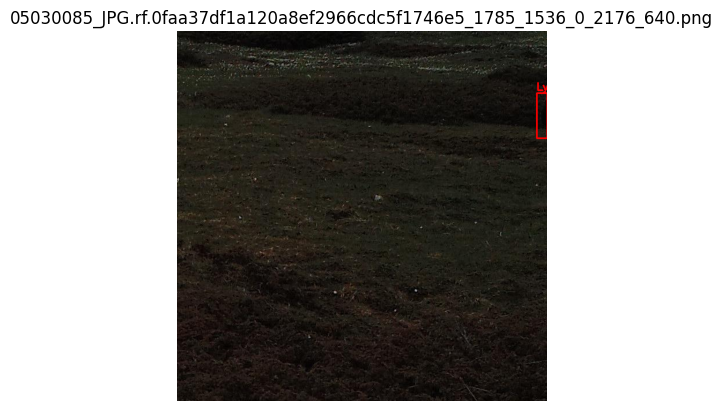

../dataset_sliced/split_1\val\images\05070320_JPG.rf.4a994c5557e020e1e51e0e1267466f63_1369_1536_512_2176_1152.png
['0', '0.995313', '0.314063', '0.009375', '0.053125']
['0', '0.935937', '0.321094', '0.071875', '0.0515625']
0.000498046875
5.666666666666667


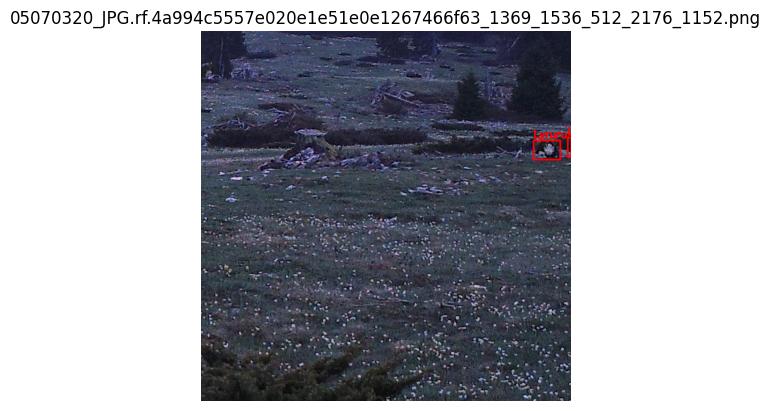

../dataset_sliced/split_1\val\images\05130330_JPG.rf.f891ad35226682411182e7813e54913e_1919_512_0_1152_640.png
['0', '0.0132812', '0.161719', '0.0265625', '0.0984375']
['0', '0.128125', '0.153125', '0.1375', '0.075']
0.0026147460937499998
3.7058823529411766


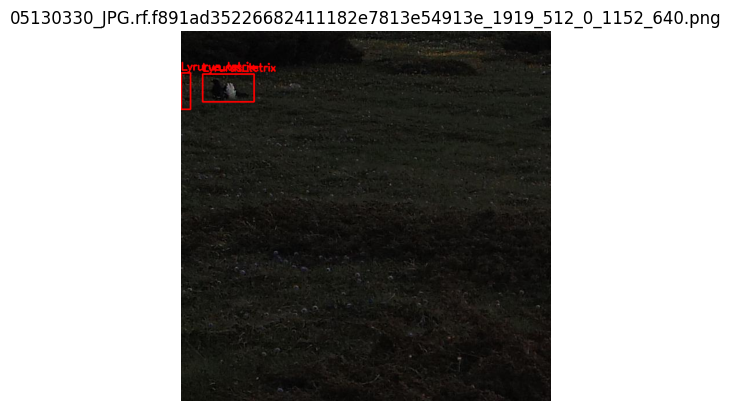

../dataset_sliced/split_1\val\images\05160475_JPG.rf.6828bd1131a2ac84171ce180e246fd30_1370_1536_0_2176_640.png
['0', '0.992969', '0.303906', '0.0140625', '0.0703125']
['0', '0.464062', '0.153906', '0.071875', '0.0609375']
0.00098876953125
5.0


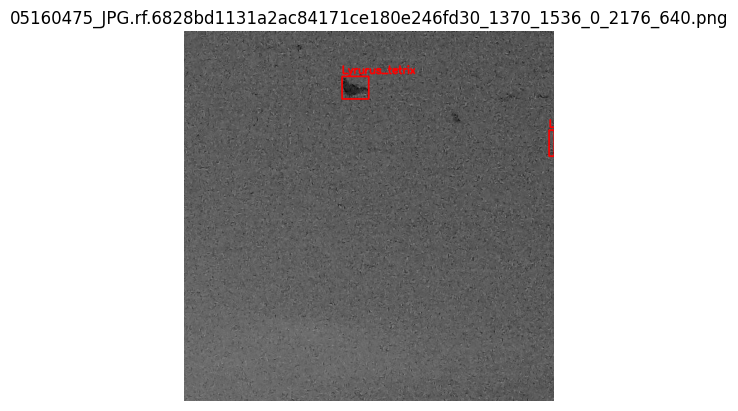

../dataset_sliced/split_1\val\images\05250717_JPG.rf.5a74202d95c620f641cd796fc685b1be_768_1024_512_1664_1152.png
['0', '0.0046875', '0.399219', '0.009375', '0.0453125']
0.0004248046875
4.833333333333333


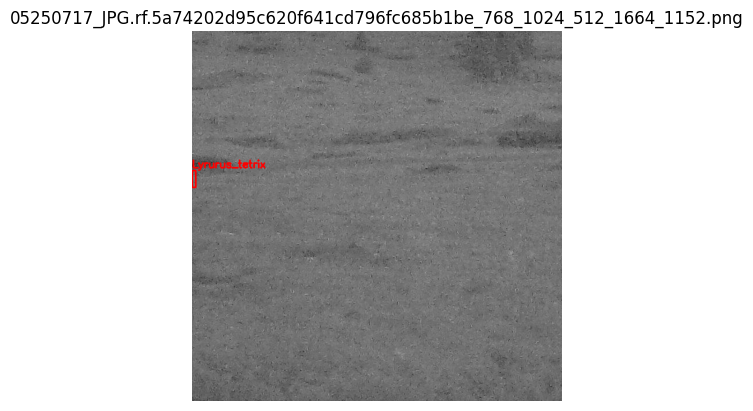

../dataset_sliced/split_1\val\images\05270792_JPG.rf.225535ec16ac80b7fc7feceacb431bfb_2504_512_1024_1152_1664.png
['0', '0.983594', '0.25625', '0.0328125', '0.259375']
0.008510742187500002
7.904761904761905


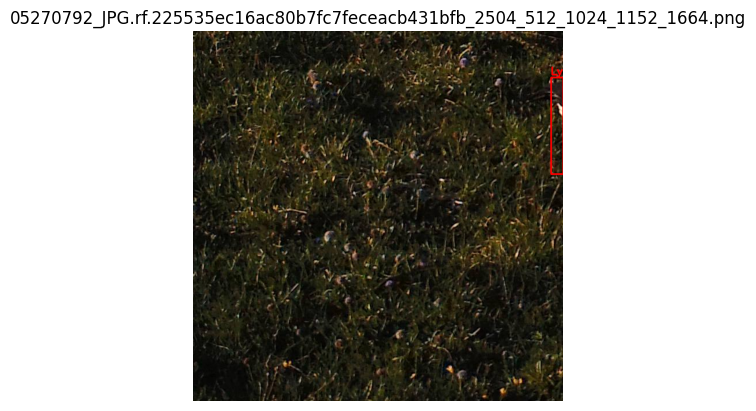

../dataset_sliced/split_1\val\images\06010892_JPG.rf.7d286763e6565fd667c39a9c5d432254_1367_1024_512_1664_1152.png
['0', '0.996094', '0.36875', '0.0078125', '0.046875']
0.0003662109375
6.0


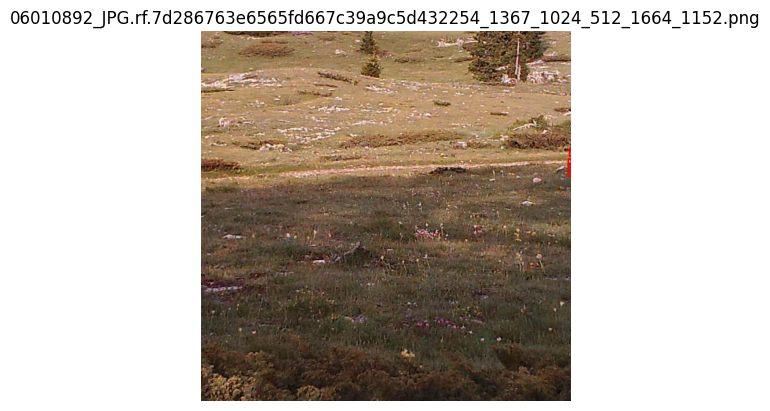

../dataset_sliced/split_1\val\images\06060024_JPG.rf.c6b8edb881e50775b407b3e73d3eff45_621_1024_0_1664_640.png
['0', '0.720313', '0.166406', '0.090625', '0.0734375']
['0', '0.00625', '0.1375', '0.0125', '0.059375']
0.0007421875
4.749999999999999


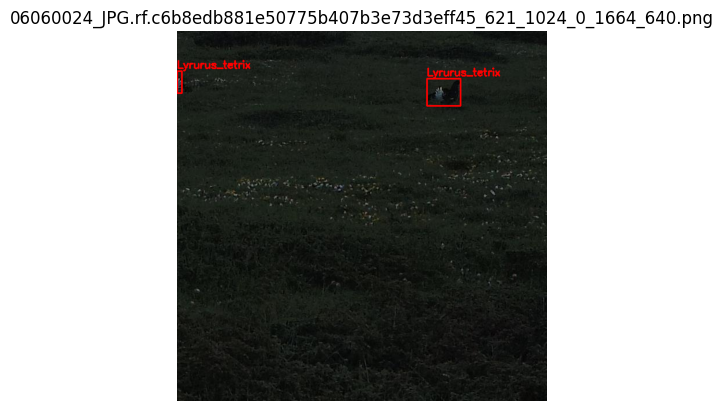

../dataset_sliced/split_1\val\images\06080039_JPG.rf.74cac44d7a41b0124604f779954b6fb4_1415_1536_512_2176_1152.png
['0', '0.00625', '0.422656', '0.0125', '0.0703125']
0.00087890625
5.625


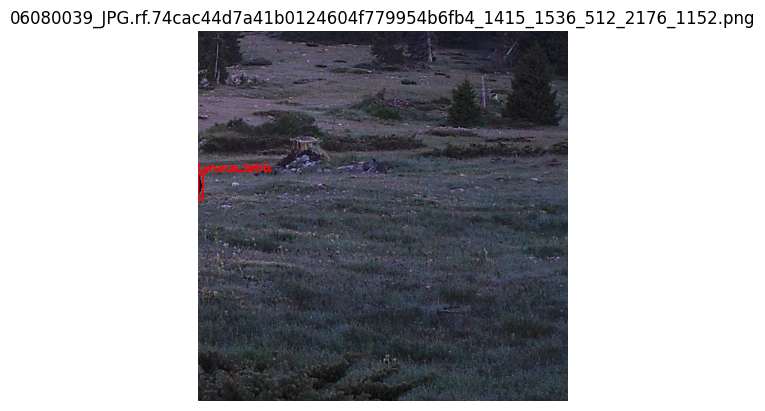

../dataset_sliced/split_1\val\images\06080064_JPG.rf.ffed0c0dc06ccf045c375cb027f8f5ca_878_1536_0_2176_640.png
['0', '0.996094', '0.242969', '0.0078125', '0.0515625']
0.00040283203125
6.6


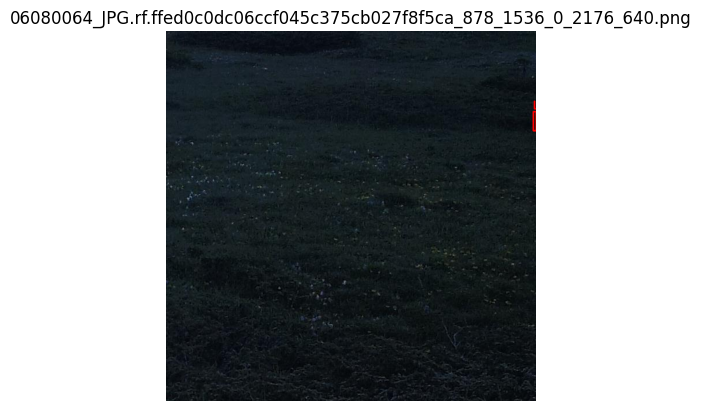

../dataset_sliced/split_1\val\images\06090122_JPG.rf.a6388fc5b35d0f6c5f22f3fad8f65023_748_512_0_1152_640.png
['0', '0.995313', '0.178125', '0.009375', '0.06875']
['0', '0.995313', '0.0648438', '0.009375', '0.0578125']
0.00064453125
7.333333333333334


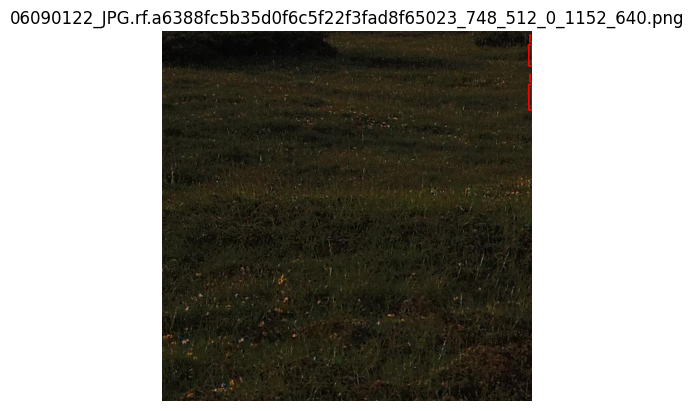

../dataset_sliced/split_1\val\images\06090122_JPG.rf.a6388fc5b35d0f6c5f22f3fad8f65023_748_512_0_1152_640.png
['0', '0.995313', '0.178125', '0.009375', '0.06875']
['0', '0.995313', '0.0648438', '0.009375', '0.0578125']
0.0005419921875
6.166666666666667


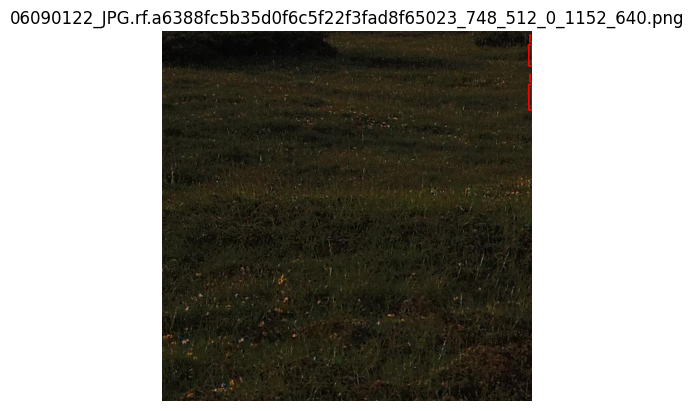

../dataset_sliced/split_1\val\images\06120129_JPG.rf.90544fa4c8357f00de4abf8866d09a8c_1563_1024_512_1664_1152.png
['0', '0.996094', '0.361719', '0.0078125', '0.0421875']
0.00032958984375
5.4


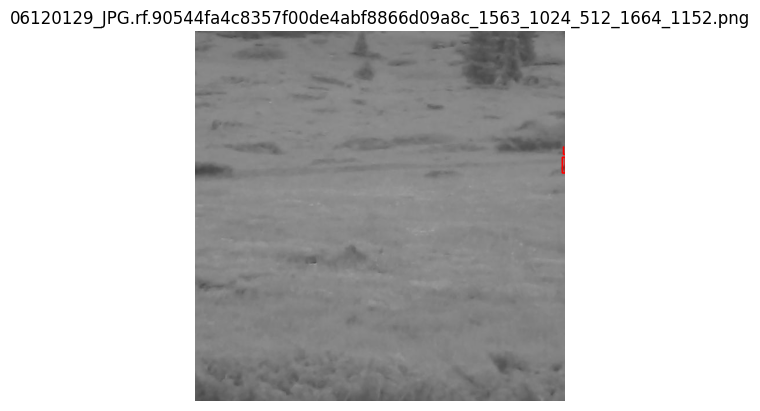

../dataset_sliced/split_1\val\images\MFDC0130_JPG.rf.c6397df1bde0b58f84de794fc9aadb82_2395_3584_0_4224_640.png
['0', '0.992969', '0.6875', '0.0140625', '0.08125']
0.0011425781250000001
5.777777777777778


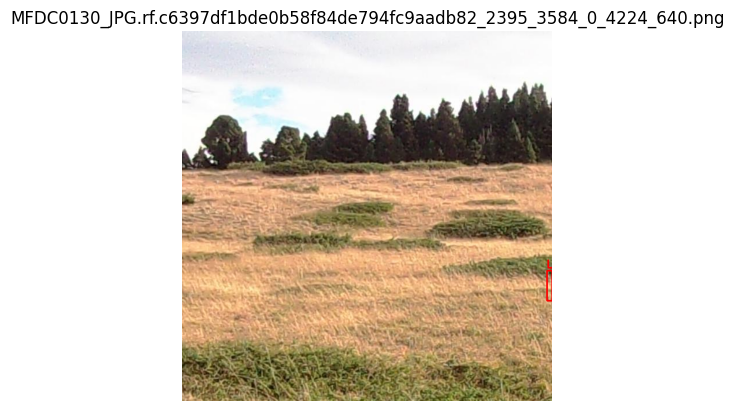

../dataset_sliced/split_1\val\images\MFDC0180_JPG.rf.7692d7be229938551f1c3dbeec3ecf8e_1678_4096_0_4736_640.png
['0', '0.645312', '0.488281', '0.015625', '0.0140625']
['0', '0.300781', '0.620313', '0.0234375', '0.025']
['0', '0.659375', '0.63125', '0.025', '0.034375']
['0', '0.00546875', '0.714063', '0.0109375', '0.0625']
0.00068359375
5.714285714285714


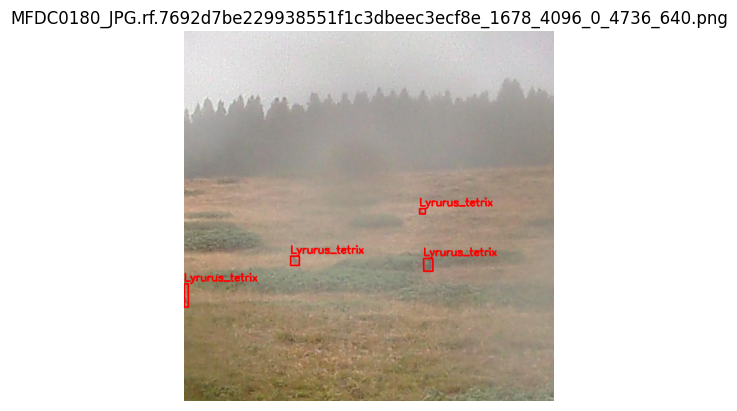

../dataset_sliced/split_1\val\images\MFDC5882_JPG.rf.f61ac8e4033b9a7d1b6cc66be7a0a117_424_3584_0_4224_640.png
['0', '0.0046875', '0.647656', '0.009375', '0.0796875']
0.0007470703124999999
8.5


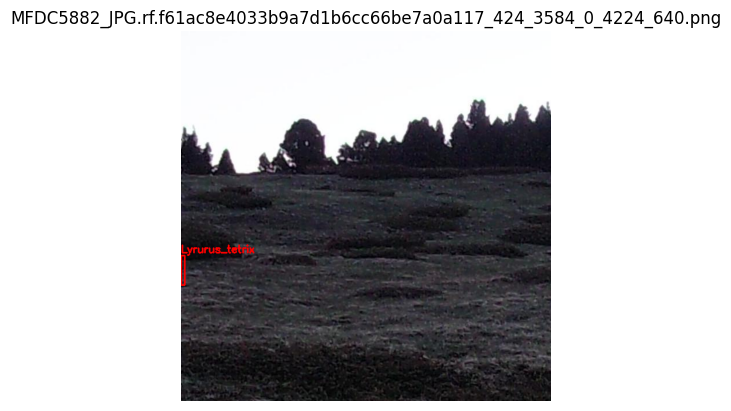

../dataset_sliced/split_1\val\images\MFDC5980_JPG.rf.be87a220381d3420029d9951472e5995_312_3584_0_4224_640.png
['0', '0.00546875', '0.622656', '0.0109375', '0.0515625']
0.0005639648437499999
4.714285714285714


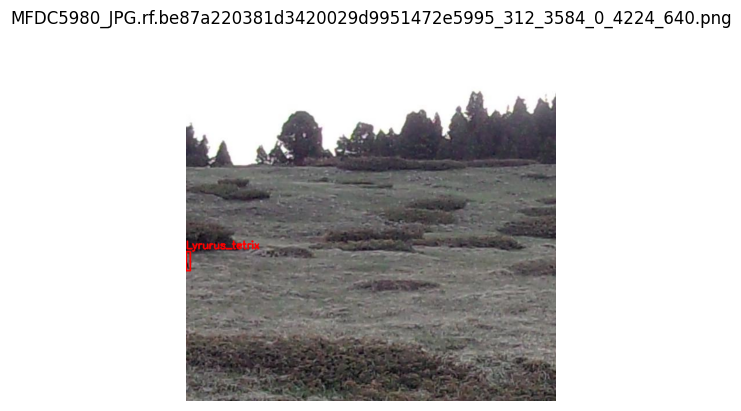

../dataset_sliced/split_1\val\images\MFDC6187_JPG.rf.ad304529eb143b7dbc1b2e031ed1cdc0_787_3584_0_4224_640.png
['0', '0.921875', '0.549219', '0.059375', '0.0453125']
['0', '0.0867187', '0.603125', '0.0796875', '0.0375']
['0', '0.0046875', '0.614062', '0.009375', '0.059375']
0.000556640625
6.333333333333333


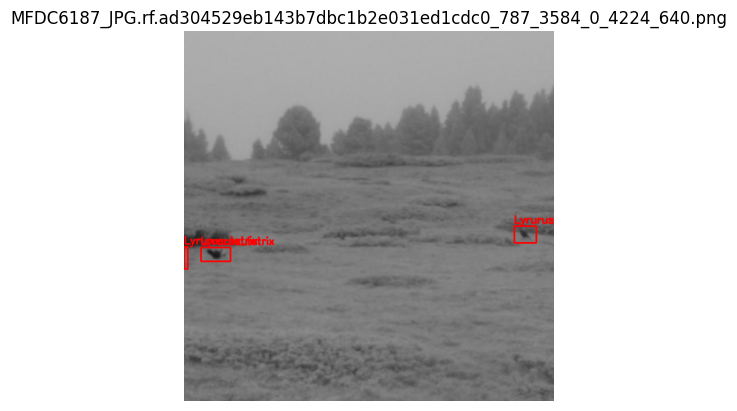

../dataset_sliced/split_1\val\images\MFDC6408_JPG.rf.88b1b3338b13cb5bd99e00ee49c21746_1788_3072_0_3712_640.png
['0', '0.00546875', '0.613281', '0.0109375', '0.0640625']
0.0007006835937499999
5.857142857142857


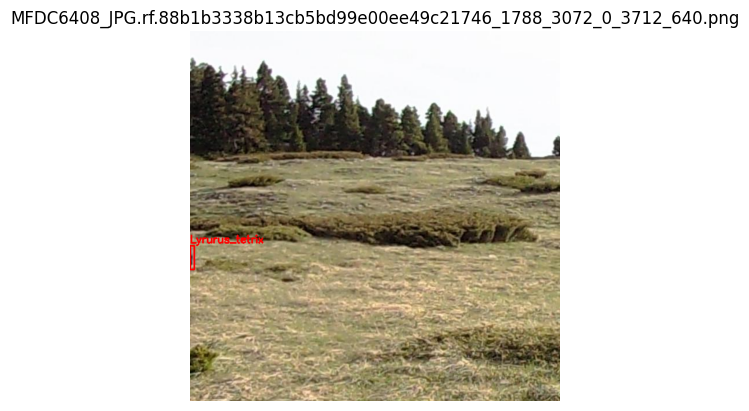

../dataset_sliced/split_1\val\images\MFDC7717_JPG.rf.3c8fd322f12d8430528d669de0f62d5a_2089_6144_0_6784_640.png
['0', '0.00390625', '0.84375', '0.0078125', '0.0375']
0.00029296875
4.8


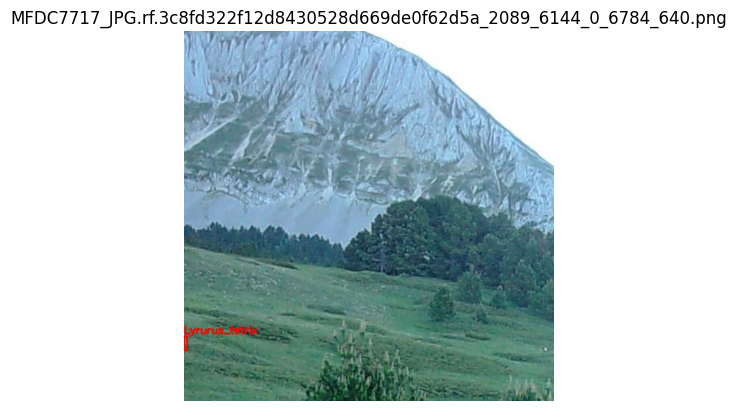

../dataset_sliced/split_1\val\images\MFDC7717_JPG.rf.3c8fd322f12d8430528d669de0f62d5a_2089_6144_512_6784_1152.png
['0', '0.00390625', '0.04375', '0.0078125', '0.0375']
0.00029296875
4.8


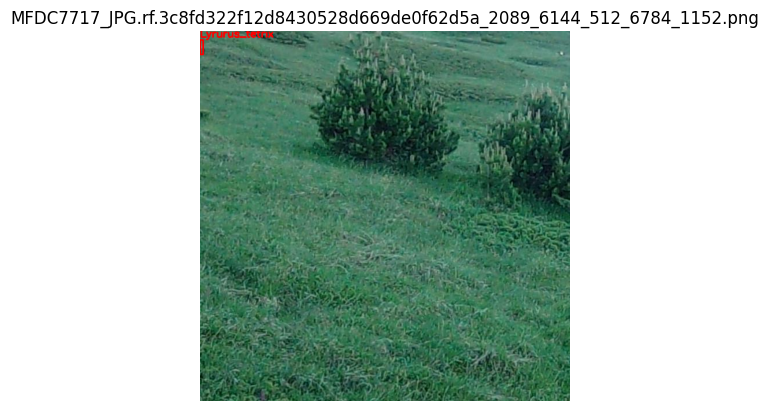

../dataset_sliced/split_1\val\images\pptly_bonneveau_1-239-_JPG.rf.fccf90c0c61c0aa6707d2436e10fe95a_386_0_512_640_1152.png
['0', '0.992969', '0.1625', '0.0140625', '0.0875']
0.00123046875
6.222222222222221


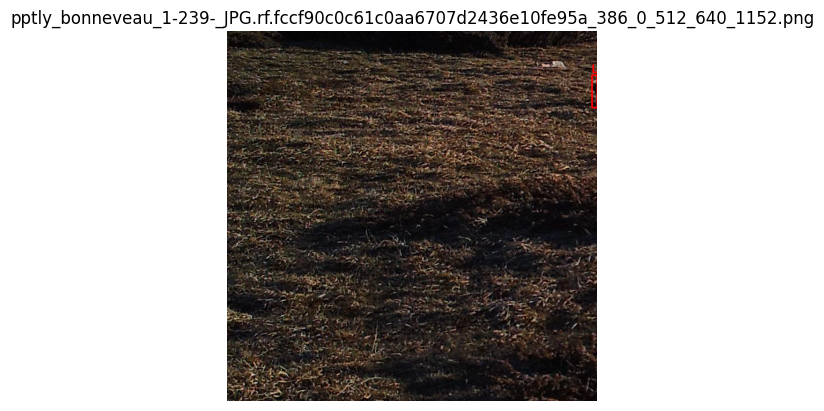

../dataset_sliced/split_1\val\images\pptly_bonneveau_1-270-_JPG.rf.63d8b6d3b690d3e75640b2e90b89ce06_2474_1952_0_2592_640.png
['0', '0.0078125', '0.946875', '0.015625', '0.06875']
0.00107421875
4.4


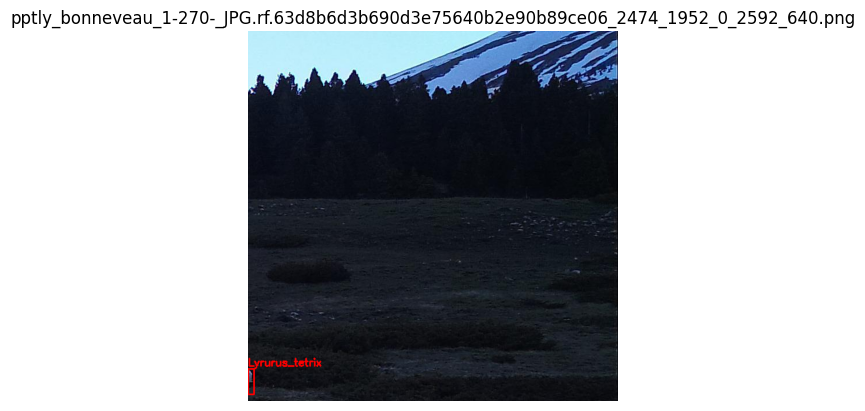

../dataset_sliced/split_1\val\images\pptly_bonneveau_1-32-_JPG.rf.12e7d8e20b27fe1f9ef69b33149d3e11_365_1952_512_2592_1152.png
['0', '0.00859375', '0.125781', '0.0171875', '0.0640625']
0.00110107421875
3.7272727272727266


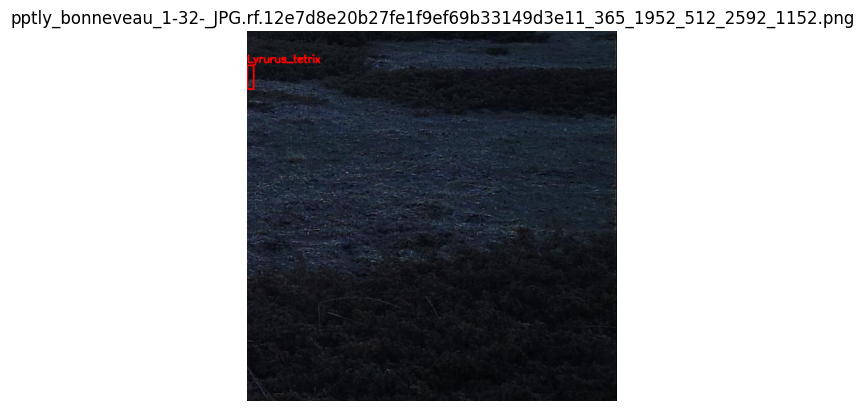

../dataset_sliced/split_1\val\images\pptly_bonneveau_1-33-_JPG.rf.df11af6f3a84290f607f2fb1b4e161c2_1342_1952_0_2592_640.png
['0', '0.00859375', '0.926562', '0.0171875', '0.065625']
0.0011279296875000002
3.818181818181818


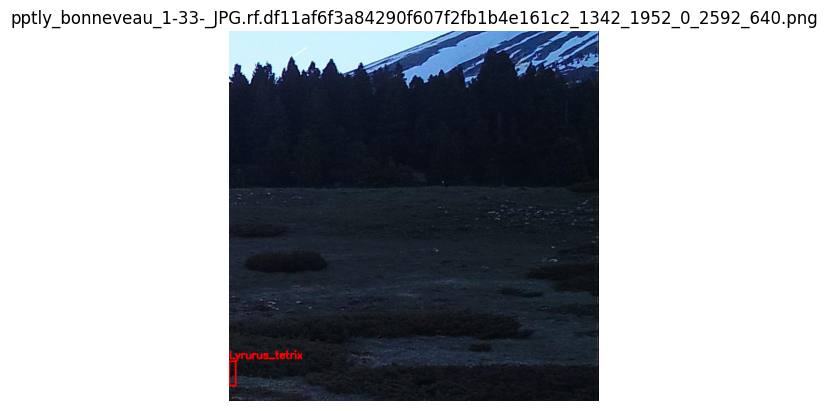

In [81]:
#PRINTING
for _,critical in df_invalid.iterrows():
    image_filename = critical["file"]
    label_filename = image_filename.replace(".png", ".txt")
    critical_img = os.path.join(dataset_path, critical["split"], "images",image_filename)
    critical_label = os.path.join(dataset_path, critical["split"], "labels",label_filename)
    print(critical_img)
    image = viewer.view_image(critical_img, critical_label,class_file)
    plt.imshow(image)
    plt.title(critical["file"])
    plt.axis("off")
    print(critical["area"])
    print(critical["aspect_ratio"])
    plt.show()

In [79]:
invalid = (
    (df["aspect_ratio"] > 3.5) &
    (df["area"] < 0.01) &
    (
        (df["x_center"] - df["width"] / 2 <= 0) |
        (df["x_center"] + df["width"] / 2 >= 1) |
        (df["y_center"] - df["height"] / 2 <= 0) |
        (df["y_center"] + df["height"] / 2 >= 1)
    )
)

In [80]:
print(f"Invalid bboxes: {invalid.sum()}")
df_invalid = df[invalid]

Invalid bboxes: 152


In [46]:
df["aspect_ratio"].max()

np.float64(13.666666666666666)

In [53]:
df["aspect_ratio"].std()

np.float64(0.7220151960825649)

In [54]:
df["z_ar_score"] = df["aspect_ratio"] - df["aspect_ratio"].mean() / df["aspect_ratio"].std()

In [55]:
df["z_ar_score"].mean()

np.float64(-0.36637392927974977)

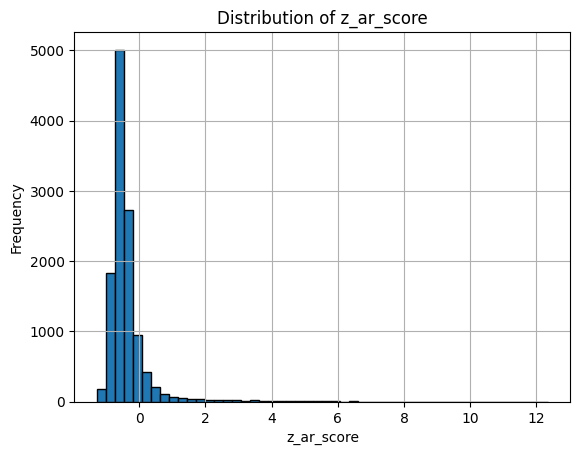

In [56]:
plt.hist(df["z_ar_score"], bins=50, edgecolor="black")
plt.title("Distribution of z_ar_score")
plt.xlabel("z_ar_score")
plt.ylabel("Frequency")
plt.grid(True)
plt.show()

In [87]:
path = os.path.join(dataset_path, "val", "labels")
dp.filter_labels(
    label_dir=Path(path),
    condition_fn=lambda cls, x, y, w, h: (
        (h / w <= 3.5) or  # on garde si aspect_ratio est ≤ 3
        (w * h >= 0.01) or  # on garde si area ≥ 0.01
        (
            (x - w / 2 > 0) and
            (x + w / 2 < 1) and
            (y - h / 2 > 0) and
            (y + h / 2 < 1)
        )
    )
)

Deleted empty label: ..\dataset_sliced\split_1\val\labels\04210198_JPG.rf.981277ebed165a25052311fac5158dcd_1108_1536_512_2176_1152.txt
Deleted empty label: ..\dataset_sliced\split_1\val\labels\04230275_JPG.rf.c63511735ef079f1f8e9646240f948ee_1254_1952_512_2592_1152.txt
Deleted empty label: ..\dataset_sliced\split_1\val\labels\04240320_JPG.rf.5882aff58543f37248eb62172bdb258f_1702_1024_512_1664_1152.txt
Deleted empty label: ..\dataset_sliced\split_1\val\labels\05020213_JPG.rf.db41d9e24935bad867078a7fd250a4e4_740_512_512_1152_1152.txt
Deleted empty label: ..\dataset_sliced\split_1\val\labels\05030085_JPG.rf.0faa37df1a120a8ef2966cdc5f1746e5_1785_1536_0_2176_640.txt
Deleted empty label: ..\dataset_sliced\split_1\val\labels\05250717_JPG.rf.5a74202d95c620f641cd796fc685b1be_768_1024_512_1664_1152.txt
Deleted empty label: ..\dataset_sliced\split_1\val\labels\05270792_JPG.rf.225535ec16ac80b7fc7feceacb431bfb_2504_512_1024_1152_1664.txt
Deleted empty label: ..\dataset_sliced\split_1\val\labels\060

In [89]:
splits = ["val", "train"]
for split in splits:
    img_path = os.path.join(dataset_path, split, "images")
    label_path = os.path.join(dataset_path, split, "labels")
    dp.remove_imgs_without_annotations(img_path, label_path)

🗑️ Suppression: 04210198_JPG.rf.981277ebed165a25052311fac5158dcd_1108_1536_512_2176_1152.png (No annotations)
🗑️ Suppression: 04230275_JPG.rf.c63511735ef079f1f8e9646240f948ee_1254_1952_512_2592_1152.png (No annotations)
🗑️ Suppression: 04240320_JPG.rf.5882aff58543f37248eb62172bdb258f_1702_1024_512_1664_1152.png (No annotations)
🗑️ Suppression: 05020213_JPG.rf.db41d9e24935bad867078a7fd250a4e4_740_512_512_1152_1152.png (No annotations)
🗑️ Suppression: 05030085_JPG.rf.0faa37df1a120a8ef2966cdc5f1746e5_1785_1536_0_2176_640.png (No annotations)
🗑️ Suppression: 05250717_JPG.rf.5a74202d95c620f641cd796fc685b1be_768_1024_512_1664_1152.png (No annotations)
🗑️ Suppression: 05270792_JPG.rf.225535ec16ac80b7fc7feceacb431bfb_2504_512_1024_1152_1664.png (No annotations)
🗑️ Suppression: 06010892_JPG.rf.7d286763e6565fd667c39a9c5d432254_1367_1024_512_1664_1152.png (No annotations)
🗑️ Suppression: 06080039_JPG.rf.74cac44d7a41b0124604f779954b6fb4_1415_1536_512_2176_1152.png (No annotations)
🗑️ Suppression: 